# Dataset preprocessing

import packages

In [1]:
%load_ext autoreload
%autoreload 2
import scanpy as sc
import anndata as ad
import pandas as pd
from matplotlib import rcParams
import matplotlib.pyplot as pl
import numpy as np
import scrublet as scr
import seaborn as sb
import scipy as sci
from scipy.sparse import csr_matrix
#from scanpy.tools import rna_velocity
import scvelo as scv
import loompy
import leidenalg
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
from scipy import sparse
import bbknn
import os
import glob
from itertools import chain
import seaborn as sn
from datetime import datetime

import function file

In [2]:
import EC_processing_Functions as seq

In [17]:
sc.settings.set_figure_params(dpi=50,dpi_save=600,)

In [3]:
sc.logging.print_versions()

scanpy==1.5.1 anndata==0.7.6 umap==0.4.6 numpy==1.19.2 scipy==1.5.2 pandas==1.1.3 scikit-learn==0.23.2 statsmodels==0.12.0 python-igraph==0.9.8 louvain==0.7.1


In [37]:
# set directory to folder above dataset location

## Dataset 1 - 3D suspendion culture from day 0 to day 9 

This dataset is uses in Fig. 1, Fig. 2, and Fig. S1

load count matrices and perform 

In [6]:
d0=sc.read_h5ad('./scanpy_AnnData/MUC13080/filtered_feature_bc_matrix.h5ad', 
                backed=None, chunk_size=6000)
d3=sc.read_h5ad('./scanpy_AnnData/MUC13081/filtered_feature_bc_matrix.h5ad',
                backed=None, chunk_size=6000)
d6=sc.read_h5ad('./scanpy_AnnData/MUC13082/filtered_feature_bc_matrix.h5ad',
                backed=None, chunk_size=6000)
d9=sc.read_h5ad('./scanpy_AnnData/MUC13083/filtered_feature_bc_matrix.h5ad',
                backed=None, chunk_size=6000)
adata=ad.AnnData.concatenate(d0,d3,d6,d9,join='outer', 
                             batch_categories=['day 0', 'day 3', 'day 6','day 9'],
                             index_unique='-') #combine datasets

Trying to set attribute `.obs` of view, copying.


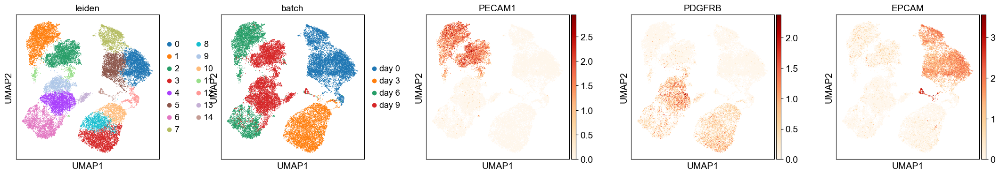

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.40
Detected doublet rate = 1.0%
Estimated detectable doublet fraction = 73.4%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 1.4%
Elapsed time: 65.1 seconds


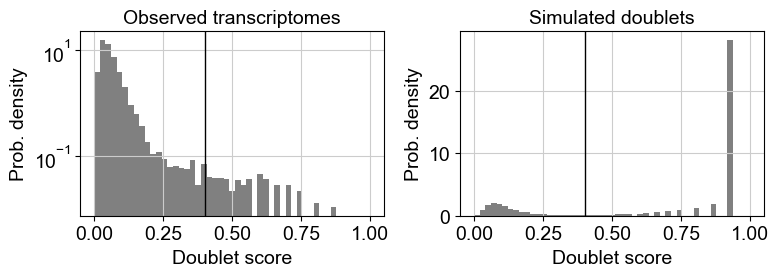

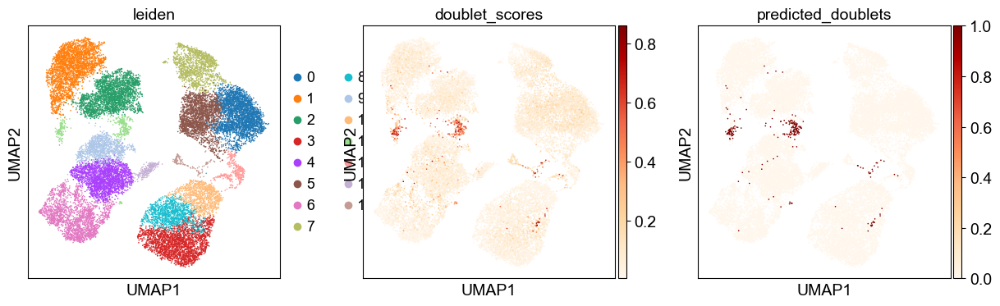

In [7]:
adata=seq.scRNA(adata,0.5)

In [8]:
data=adata.copy()

dubletprediction

In [9]:
adata=ad.AnnData.concatenate(d0,d3,d6,d9,join='outer', 
                             batch_categories=['day 0', 'day 3', 'day 6','day 9'],
                             index_unique='-') #combine datasets

adata=adata[np.isin(adata.obs_names,data.obs_names)]

sc.pp.filter_genes(adata, min_cells=1)
import doubletdetection
clf = doubletdetection.BoostClassifier(
    n_iters=10,
    clustering_algorithm="leiden",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score


data.obs["doublet"]=adata.obs.doublet
data.obs["doublet_score"]=adata.obs.doublet_score

Trying to set attribute `.var` of view, copying.


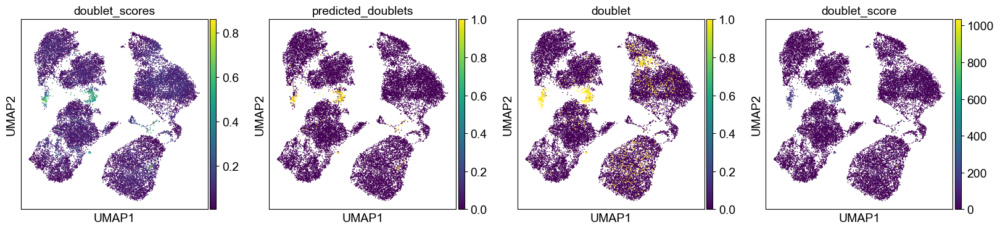

In [10]:
sc.pl.umap(data, color=['doublet_scores','predicted_doublets',"doublet", "doublet_score"
                        ] )

In [11]:
adata=data.copy()

163

767

69

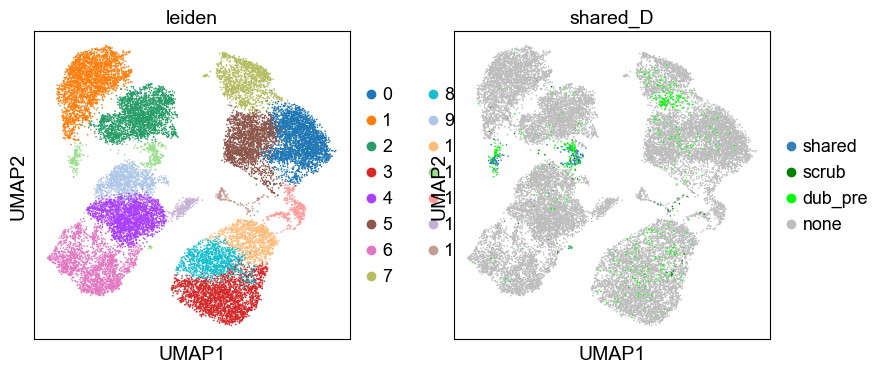

In [12]:
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 1))
ref_cluster = pd.Categorical(adata.obs.shared_D,categories=['True','False','shared','scrub','dub_pre',"none"])
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='shared'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == False) & (adata.obs.doublet == 1))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='dub_pre'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 0))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='scrub'
x = ref_cluster.isna()
ref_cluster[x]='none'

adata.obs['shared_D'] = ref_cluster
adata.obs['shared_D'].cat.remove_unused_categories(inplace=True)
adata.uns['shared_D_colors']=['#377eb8',"green","lime",'#bdbdbd']
# display(ref_cluster)

sc.pl.umap(adata, color=["leiden",  "shared_D"],
#            ncols=3,
#           color_map="OrRd"#,save="20211005_0t09_Coexp.pdf"
          )

In [13]:
pd.crosstab(adata.obs.shared_D,"A")

col_0,A
shared_D,
shared,163
scrub,69
dub_pre,767
none,21193


In [14]:
adata=adata[np.isin(adata.obs.shared_D,["none"])]

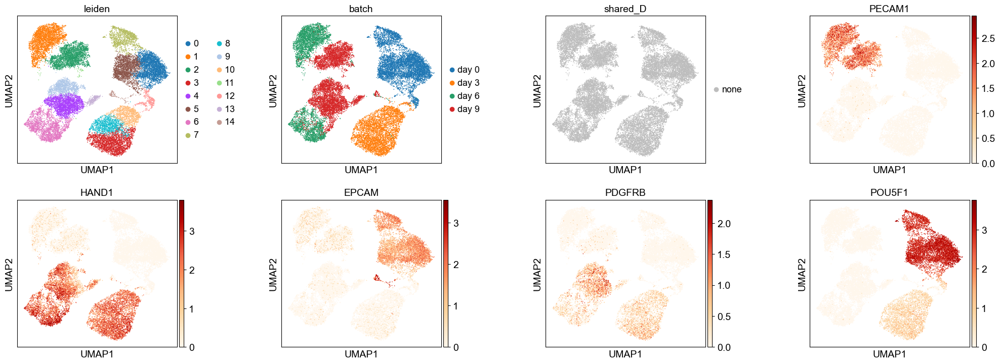

In [15]:
sc.pl.umap(adata, color=["leiden",'batch','shared_D',
                      'PECAM1','HAND1','EPCAM','PDGFRB','POU5F1'], color_map="OrRd",ncols=4,
           wspace=0.5)

Trying to set attribute `.obs` of view, copying.


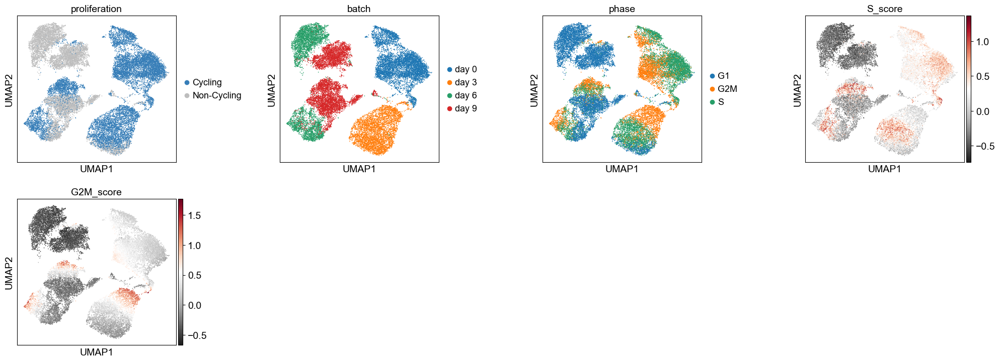

In [16]:
adata=seq.cell_cycle(adata)

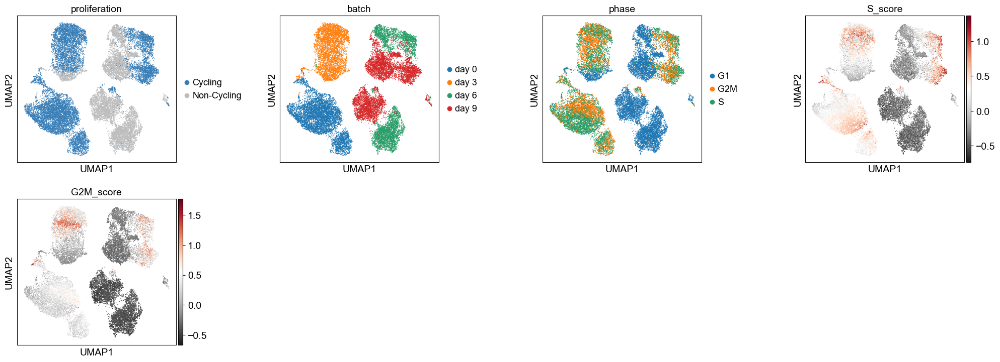

In [17]:
adata=seq.cell_cycle_regression(adata)

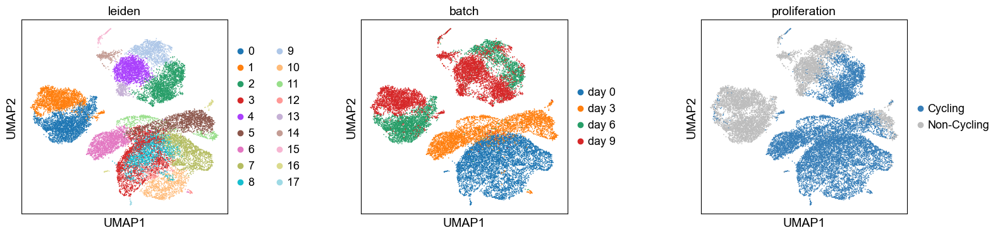

In [41]:
sc.pp.combat(adata,key="batch")
sc.tl.umap(adata)
sc.tl.leiden(adata,.5)
sc.pl.umap(adata,color=["leiden","batch","proliferation"],wspace=.5)

annotate found clusters

In [ ]:
# with cc regresseion
adata.obs['leiden_anno']=adata.obs['leiden']
ss=adata.obs['leiden_anno']
ss=ss.replace('0','angioblast')#
ss=ss.replace('1','angioblast')
ss=ss.replace('2','mural')
ss=ss.replace('3','pluripotent')
ss=ss.replace('4','mural')
ss=ss.replace('5','mesenchymo-angioblast')
ss=ss.replace('6','mesenchymo-angioblast')
ss=ss.replace('7','pluripotent')
ss=ss.replace('8','pluripotent')
ss=ss.replace('9','mural')
ss=ss.replace('10','pluripotent')
ss=ss.replace('11','mesenchymo-angioblast')
ss=ss.replace('12','pluripotent')
ss=ss.replace('13','mural')
ss=ss.replace('14','mural')
ss=ss.replace('15','epithelial')
ss=ss.replace('16','mesenchymo-angioblast')
ss=ss.replace('17','pluripotent')
adata.obs['leiden_anno']=ss

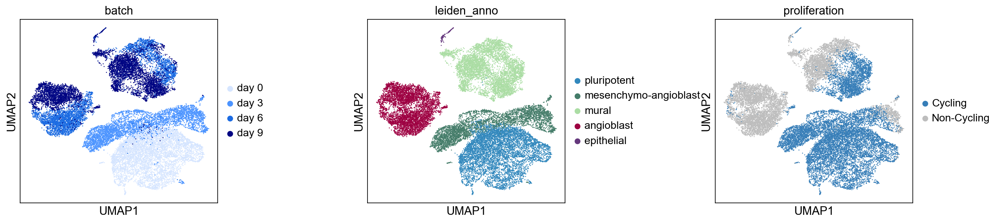

In [10]:
adata.obs['leiden_anno'].cat.reorder_categories([
    'pluripotent', 'mesenchymo-angioblast', 'mural', 'angioblast', 
       'epithelial'], inplace=True)
adata.uns['leiden_anno_colors']=['#3288bd', '#447c69', '#abdda4', #'#fdae61',
                                 '#9e0142', '#65387d','#a7b4b4']
adata.uns['batch_colors']=['#d5e5ff', #'#a5c9ff', 
             '#4c94ff', '#1b6be2', #'#1256bc', 
             '#000583']
sc.pl.umap(adata, color=["batch", "leiden_anno", "proliferation"],wspace=.6)

In [11]:
adata.write(r"./processed/dataset_1.h5ad",compression="gzip")

## Dataset 2 - 3D suspension culture from day 0 to day 9, velocity integration

This dataset is used in Fig. 2

In [33]:
adata=sc.read_h5ad("./processed/dataset_1.h5ad")

In [38]:
glob.glob(r'./velocyto/MUC1308'+str(i)+'/*.loom')

['./velocyto/MUC13080\\possorted_genome_bam_AD4SD.loom']

read and combine loom files to connect unspliced with spliced data

In [100]:
loompy.combine([glob.glob(r'./velocyto/MUC13080/*.loom')[0], #d0
                glob.glob(r'./velocyto/MUC13081/*.loom')[0], #d3
                glob.glob(r'./velocyto/MUC13082/*.loom')[0], #d6
                glob.glob(r'./velocyto/MUC13083/*.loom')[0], ], #d9
               r"./processed/day_0to9_combined.loom")

In [39]:
name_l=list()
for i in range(len(adata.obs.batch.cat.categories)):
    descr=glob.glob(r'./velocyto/MUC1308'+str(i)+'/*.loom')[0]
    name_l.append(descr[-10:-5])
name_l

['AD4SD', '5WG98', 'TW480', 'EMJIL']

In [43]:
adata=adata[np.isin(adata.obs.leiden_anno,[el for el in adata.obs.leiden_anno.cat.categories if not "epi" in el])]

Filtered out 3548 genes that are detected in less than 3 cells (spliced).
Filtered out 5241 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:05) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 1/8 cores)



    finished (1:25:38) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:14) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)



    finished (0:02:50) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:10) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing terminal states
    identified 6 regions of root cells and 3 regions of end points .
    finished (0:00:05) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:17) --> added 
    'latent_time', shared time (adata.obs)


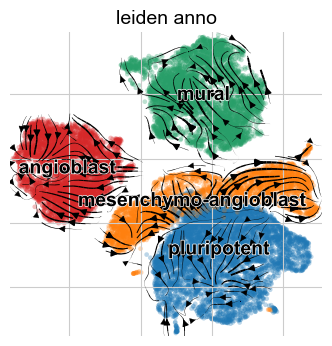

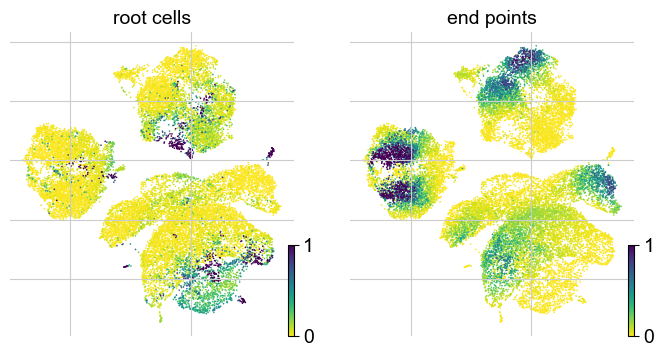

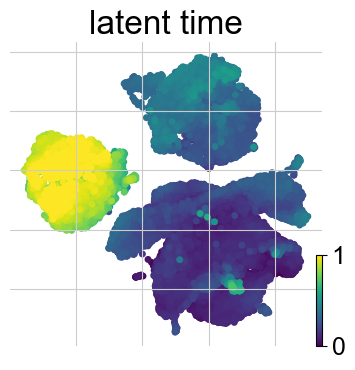

In [48]:
nr=[2000]
datalist=nr.copy()
for i in range(len(nr)):
    a=adata.copy()
    a.var_names_make_unique()
    a.var_names_make_unique()
    scv.pp.filter_and_normalize(a, 
                                min_cells=3,
                                min_counts=2,
                                min_shared_counts=20, 
                                n_top_genes=nr[i])
    scv.pp.moments(a, n_pcs=40, n_neighbors=10)
    scv.tl.recover_dynamics(a)
    #velocity
    scv.tl.velocity(a, mode='dynamical')
    scv.tl.velocity_graph(a)
    scv.pl.velocity_embedding_stream(a, basis='umap',color='leiden_anno')

    scv.tl.terminal_states(a)
    scv.pl.scatter(a, color=['root_cells', 'end_points'])
    scv.tl.recover_latent_time(a)
    scv.pl.scatter(a, color='latent_time', fontsize=24, size=100,
                   color_map='viridis', perc=[2, 98], colorbar=True, rescale_color=[0,1])
    a.write('./processed/dataset_2.h5ad',compression="gzip")

## Dataset 3 - 3D suspendion culture from day 9, two independent differentiations 

This dataset is used in Fig. S3

load count matrices and perform 

In [6]:
d9_1=sc.read_h5ad('./scanpy_AnnData/MUC13083/filtered_feature_bc_matrix.h5ad', backed=None, chunk_size=6000)
d9_2=sc.read_h5ad('./scanpy_AnnData/MUC18112/filtered_feature_bc_matrix.h5ad',
                  backed=None, chunk_size=6000)

In [7]:
adata=ad.AnnData.concatenate(d9_1,d9_2, join='outer', batch_categories=["d09_1","d09_2"],
                             index_unique='-') #combine datasets

Trying to set attribute `.obs` of view, copying.


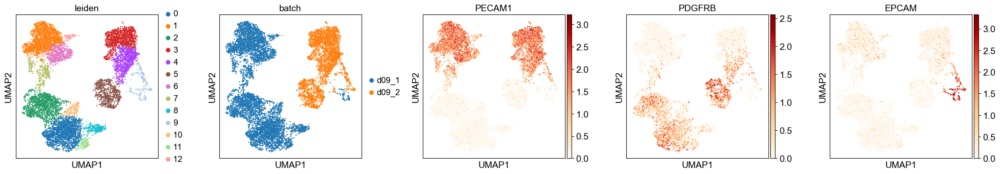

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.46
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 59.7%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.7%
Elapsed time: 23.5 seconds


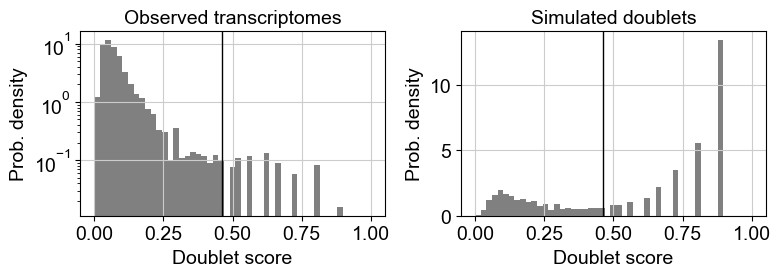

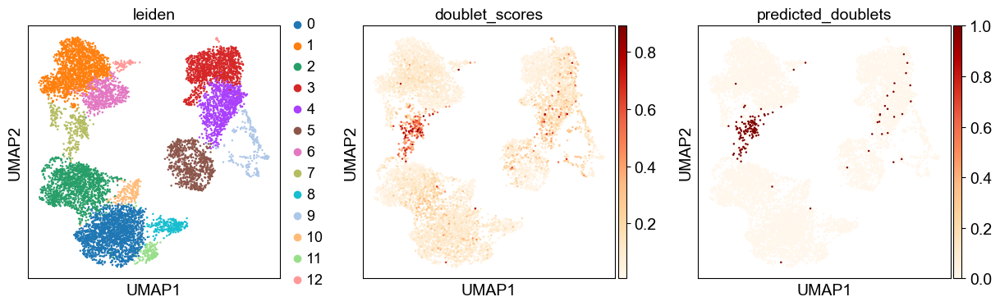

In [8]:
adata=seq.scRNA(adata,0.5)

In [9]:
data=adata.copy()

dubletprediction

In [10]:
adata=ad.AnnData.concatenate(d9_1,d9_2, join='outer', batch_categories=["d09_1","d09_2"],
                             index_unique='-') #combine datasets

adata=adata[np.isin(adata.obs_names,data.obs_names)]

sc.pp.filter_genes(adata, min_cells=1)
import doubletdetection
clf = doubletdetection.BoostClassifier(
    n_iters=10,
    clustering_algorithm="leiden",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score


data.obs["doublet"]=adata.obs.doublet
data.obs["doublet_score"]=adata.obs.doublet_score

Trying to set attribute `.var` of view, copying.


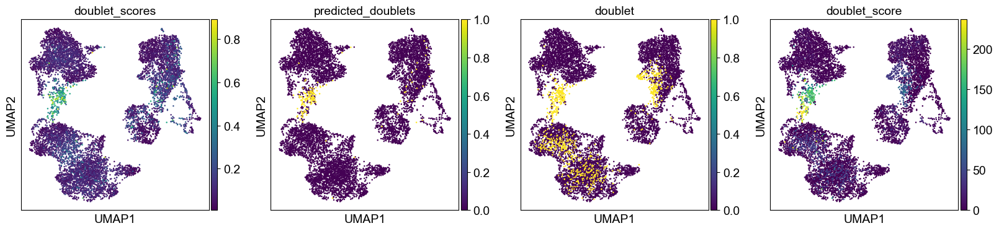

In [11]:
sc.pl.umap(data, color=['doublet_scores','predicted_doublets',"doublet", "doublet_score"
                        ] )

In [12]:
adata=data.copy()

119

684

32

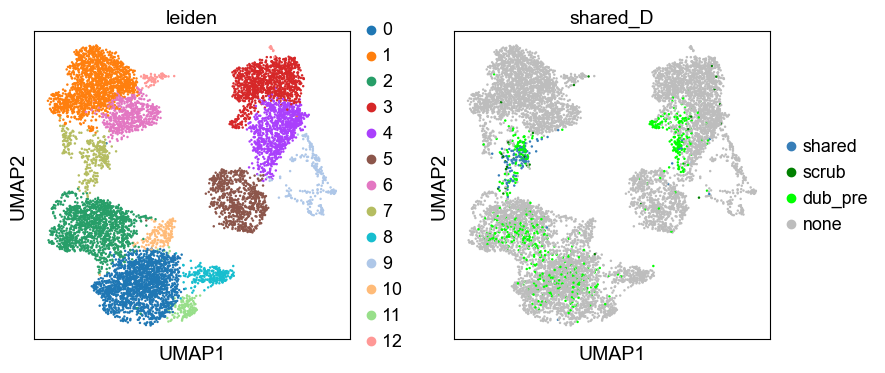

In [13]:
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 1))
ref_cluster = pd.Categorical(adata.obs.shared_D,categories=['True','False','shared','scrub','dub_pre',"none"])
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='shared'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == False) & (adata.obs.doublet == 1))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='dub_pre'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 0))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='scrub'
x = ref_cluster.isna()
ref_cluster[x]='none'

adata.obs['shared_D'] = ref_cluster
adata.obs['shared_D'].cat.remove_unused_categories(inplace=True)
adata.uns['shared_D_colors']=['#377eb8',"green","lime",'#bdbdbd']
# display(ref_cluster)

sc.pl.umap(adata, color=["leiden",  "shared_D"],
#            ncols=3,
#           color_map="OrRd"#,save="20211005_0t09_Coexp.pdf"
          )

In [14]:
adata=adata[adata.obs.shared_D=="none"]

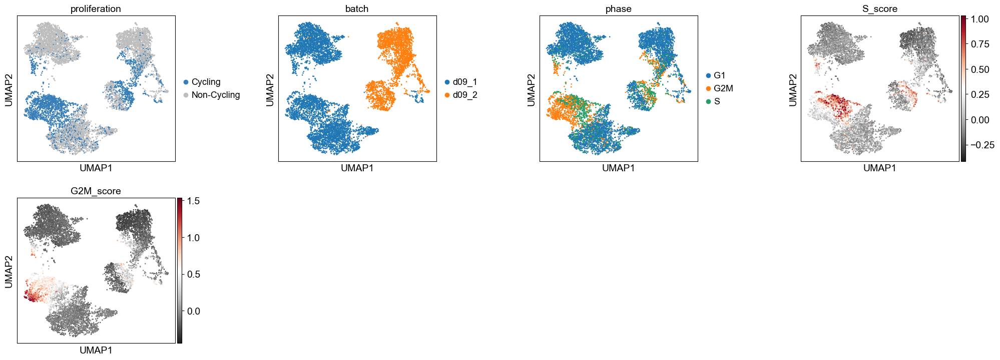

In [28]:
adata=seq.cell_cycle(adata)

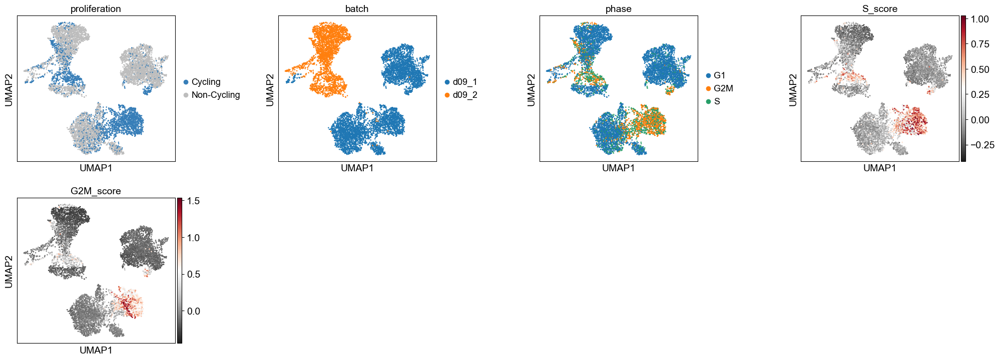

In [29]:
adata=seq.cell_cycle_regression(adata)

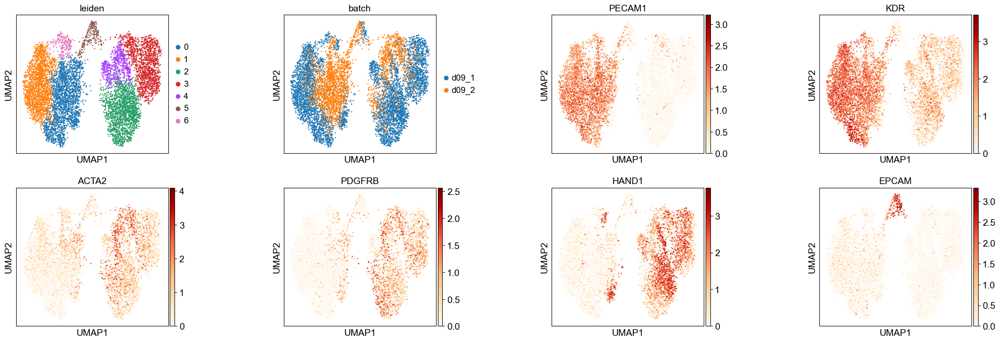

In [50]:
num_pcs = 40
mum_neighbour = 10
adata = bbknn.bbknn(adata, neighbors_within_batch=mum_neighbour, n_pcs=num_pcs, trim=0, 
                              copy=True)
sc.pl.umap(adata,color=['leiden','batch',"PECAM1","KDR",'ACTA2','PDGFRB','HAND1','EPCAM'],
      wspace=0.6, color_map="OrRd")

annotate clusters to cell types

In [63]:
adata.obs['leiden_anno']=adata.obs['leiden']
ss=adata.obs['leiden_anno']
ss=ss.replace('0','EC')#
ss=ss.replace('1','EC')#
ss=ss.replace('2','MC')
ss=ss.replace('3','MC')
ss=ss.replace('4','MC')#
ss=ss.replace('5','Epi')#
ss=ss.replace('6','EC')
adata.obs['leiden_anno']=ss

In [76]:
pdf=adata.obs[['leiden',"batch","leiden_anno"]]
pdf["batch_anno"]=pdf["leiden_anno"]
ref_cluster = pd.Categorical(pdf['batch_anno'],categories=['True','False','MC_1','MC_2',
                                                           'EC_1','EC_2','Epi_1',"Epi_2"])
pdf['batch_anno'] = ((pdf.leiden_anno == "MC") & (pdf.batch == "d09_1"))
x = pdf['batch_anno'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='MC_1'
pdf['batch_anno'] = ((pdf.leiden_anno == "MC") & (pdf.batch == "d09_2"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='MC_2'
display(len([el for el in x if el == True]))
pdf['batch_anno'] = ((pdf.leiden_anno == "EC") & (pdf.batch == "d09_1"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='EC_1'
display(len([el for el in x if el == True]))
pdf['batch_anno'] = ((pdf.leiden_anno == "EC") & (pdf.batch == "d09_2"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='EC_2'
display(len([el for el in x if el == True]))
pdf['batch_anno'] = ((pdf.leiden_anno == "Epi") & (pdf.batch == "d09_1"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='Epi_1'
display(len([el for el in x if el == True]))
pdf['batch_anno'] = ((pdf.leiden_anno == "Epi") & (pdf.batch == "d09_2"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='Epi_2'
display(len([el for el in x if el == True]))
ref_cluster
adata.obs['ct_bybatch'] = ref_cluster
adata.obs['ct_bybatch'].cat.remove_unused_categories(inplace=True)

3118

826

2632

1797

63

165

In [78]:
adata.uns["ct_bybatch_colors"]=['#447c69', '#abdda4',#'#b5bd61', '#ffbb78', 
                                '#d62728', '#9e0142', '#65387d','#a7b4b4']
sc.settings.set_figure_params(dpi=50,dpi_save=600,)
sc.pl.umap(adata,color=["ct_bybatch"],
           title=[''], legend_loc=None, frameon=False,
       save="_d9_1_2.png",
           color_map="OrRd",
      wspace=0.6)

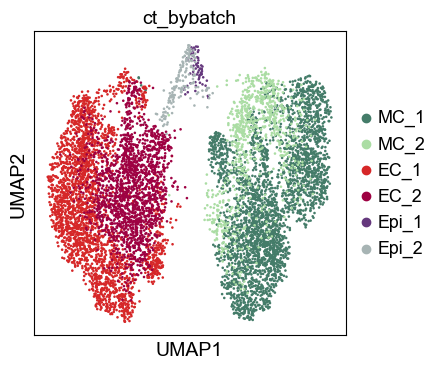

In [87]:
sc.pl.umap(adata,color=["ct_bybatch"],
      wspace=0.6)

In [49]:
adata.write(r"./processed/dataset_3.h5ad",compression="gzip")

## Dataset 4 - Comparison 3D and 2D cell culture on day 3 and 4, respectively 

This dataset is used in Fig. S2

In [6]:
d4_mc=sc.read_10x_h5(r'./McCracken/GSM3814886_day4_filtered_gene_bc_matrices_h5.h5')
d4_mc.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [7]:
d3=sc.read_h5ad(r'.\scanpy_AnnData\MUC13081\filtered_feature_bc_matrix.h5ad', 
                   backed=None, chunk_size=6000)

In [8]:
adata=ad.AnnData.concatenate(d3,d4_mc, join='inner', batch_categories=["day03","day04"],
                             index_unique='-') #combine datasets

Trying to set attribute `.obs` of view, copying.


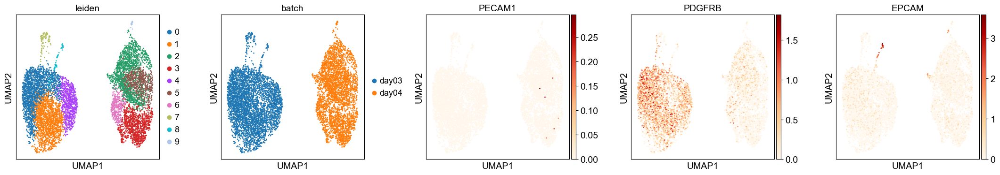

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.68
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 49.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 0.0%
Elapsed time: 10.0 seconds


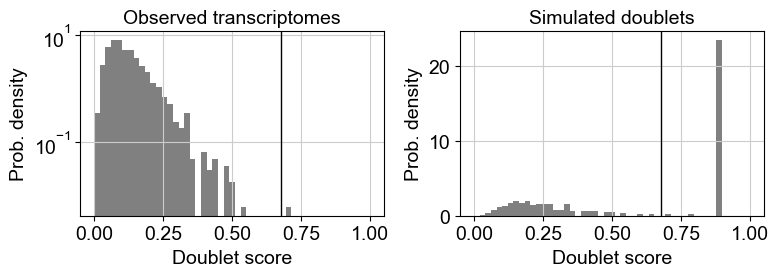

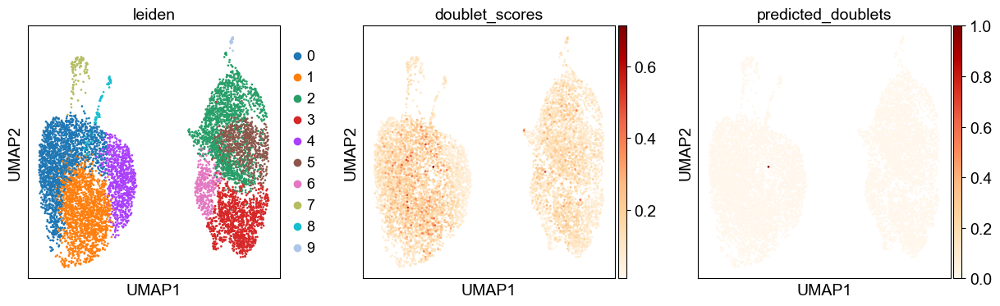

In [9]:
adata=seq.scRNA(adata,0.5)

In [10]:
data=adata.copy()

dubletprediction

In [11]:
adata=ad.AnnData.concatenate(d3,d4_mc,join='outer', 
                             batch_categories=["day03","day04"],
                             index_unique='-') #combine datasets

adata=adata[np.isin(adata.obs_names,data.obs_names)]

sc.pp.filter_genes(adata, min_cells=1)
import doubletdetection
clf = doubletdetection.BoostClassifier(
    n_iters=10,
    clustering_algorithm="leiden",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score


data.obs["doublet"]=adata.obs.doublet
data.obs["doublet_score"]=adata.obs.doublet_score

Trying to set attribute `.var` of view, copying.


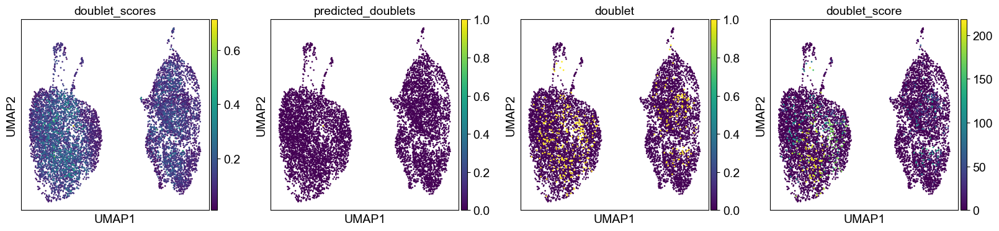

In [12]:
sc.pl.umap(data, color=['doublet_scores','predicted_doublets',"doublet", "doublet_score"
                        ] )

In [13]:
adata=data.copy()

1

351

0

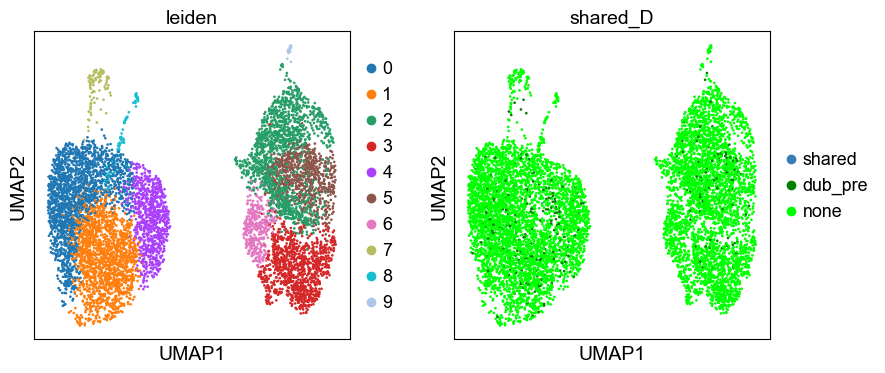

In [14]:
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 1))
ref_cluster = pd.Categorical(adata.obs.shared_D,categories=['True','False','shared','scrub','dub_pre',"none"])
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='shared'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == False) & (adata.obs.doublet == 1))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='dub_pre'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 0))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='scrub'
x = ref_cluster.isna()
ref_cluster[x]='none'

adata.obs['shared_D'] = ref_cluster
adata.obs['shared_D'].cat.remove_unused_categories(inplace=True)
adata.uns['shared_D_colors']=['#377eb8',"green","lime",'#bdbdbd']
# display(ref_cluster)

sc.pl.umap(adata, color=["leiden",  "shared_D"],
#            ncols=3,
#           color_map="OrRd"#,save="20211005_0t09_Coexp.pdf"
          )

In [15]:
pd.crosstab(adata.obs.shared_D,"A")

col_0,A
shared_D,
shared,1
dub_pre,351
none,7825


In [16]:
adata=adata[np.isin(adata.obs.shared_D,["none"])]

Trying to set attribute `.uns` of view, copying.


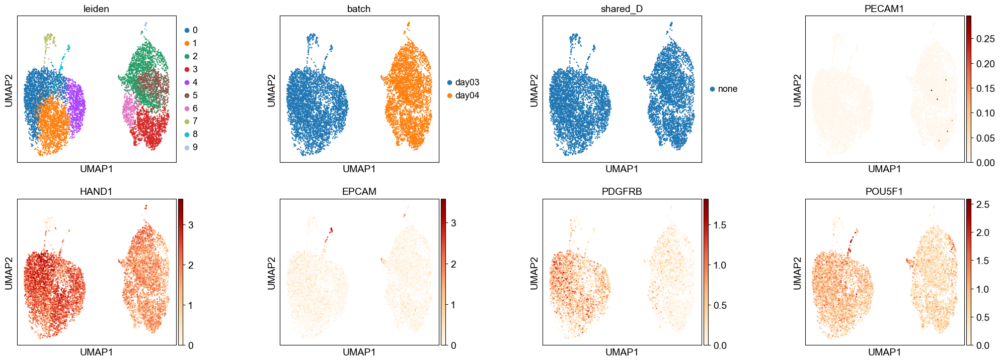

In [17]:
sc.pl.umap(adata, color=["leiden",'batch','shared_D',
                      'PECAM1','HAND1','EPCAM','PDGFRB','POU5F1'], color_map="OrRd",ncols=4,
           wspace=0.5)

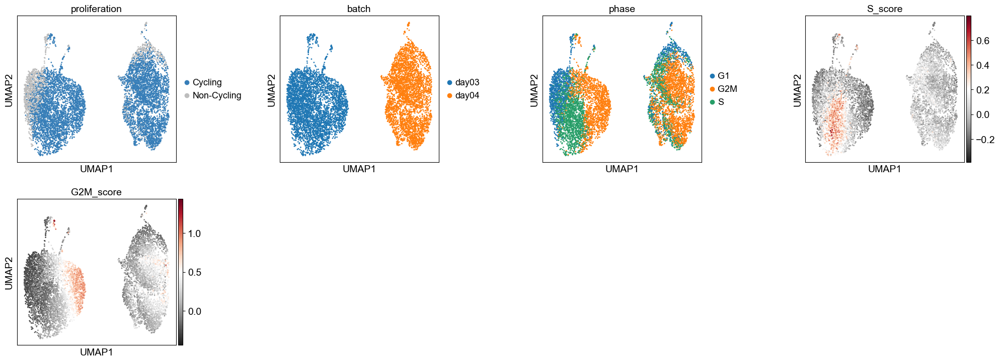

In [18]:
adata=seq.cell_cycle(adata)

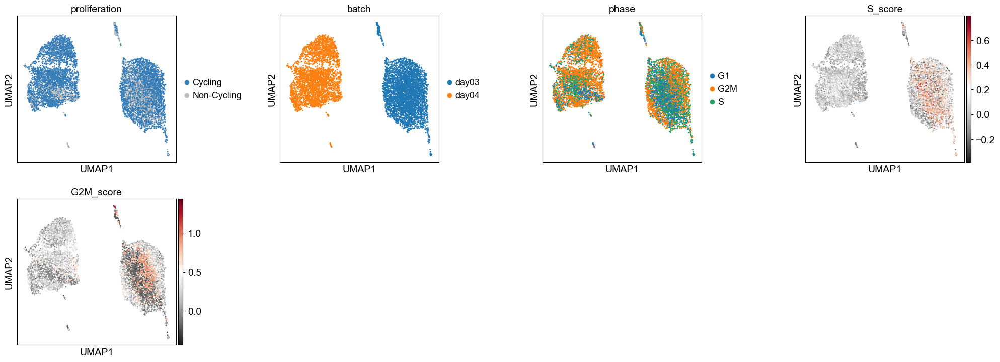

In [19]:
adata=seq.cell_cycle_regression(adata)

In [20]:
adata.uns["batch_colors"]=["#447c69","#50bead"]

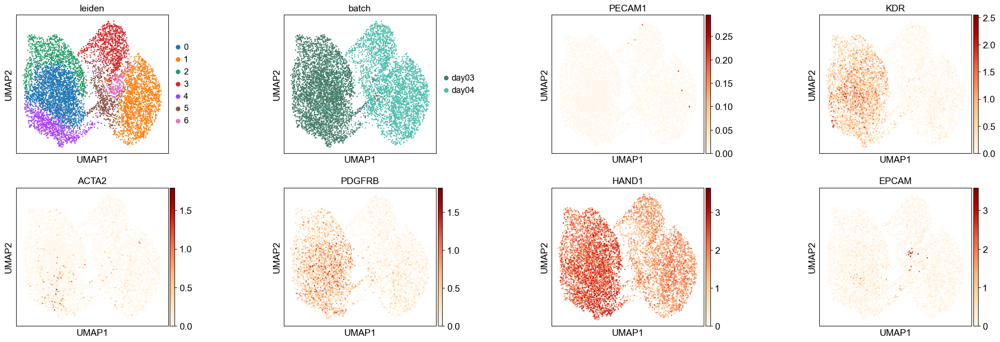

In [12]:
# num_pcs = 40
# mum_neighbour = 10
# adata = bbknn.bbknn(adata, neighbors_within_batch=mum_neighbour, n_pcs=num_pcs, trim=0, 
#                               copy=True)
# sc.tl.umap(adata)
# sc.tl.leiden(adata,.5)
sc.pl.umap(adata,color=['leiden','batch',"PECAM1","KDR",'ACTA2','PDGFRB','HAND1','EPCAM'],
      wspace=0.6, color_map="OrRd")

In [5]:
# os.chdir(r'E:\SR\EC_Data')
# glob.glob(r"E:\SR\EC_Data\processed\*.h5ad")
E:\\SR\\EC_Data\\processed\\dataset_4_day3_4_2D_3D

In [13]:
adata.write("E:\\SR\\EC_Data\\processed\\dataset_4_day3_4_2D_3D.h5ad", compression="gzip")

## Dataset 5 - Comparison 3D and 2D cell culture on day 9 and 8, respectively 

This dataset is used in Fig. 3

In [6]:
d08_McCracken=sc.read_10x_h5('./McCracken/GSM3814888_day8_rep1_filtered_gene_bc_matrices_h5.h5')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [7]:
d08_McCracken.var_names_make_unique()

In [8]:
d9_1=sc.read_h5ad('./scanpy_AnnData/MUC13083/filtered_feature_bc_matrix.h5ad', 
                  backed=None, chunk_size=6000)

In [9]:
min_cells=5
sc.pp.filter_genes(d08_McCracken, min_cells=min_cells)
sc.pp.filter_genes(d9_1, min_cells=min_cells)

In [10]:
adata_in=ad.AnnData.concatenate(d9_1,d08_McCracken, 
                                join='inner', batch_categories=["3D", '2D'],
                             index_unique='-') #combine datasets

In [11]:
adata_raw=adata_in.copy()

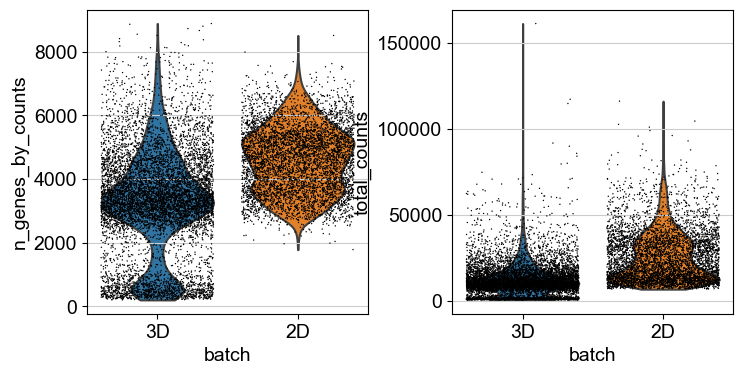

In [12]:
sc.pp.filter_cells(adata_raw, min_genes=200) #filter out 7 cells that haveless than 200 genes expressed
sc.pp.filter_genes(adata_raw, min_cells=3) #filtered out 11681 genes that are detectedin less than 3 cells
adata_raw.var['mt'] = adata_raw.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_raw, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata_raw, ['n_genes_by_counts', 'total_counts' ],groupby='batch',
         jitter=0.4, multi_panel=True)

Trying to set attribute `.obs` of view, copying.


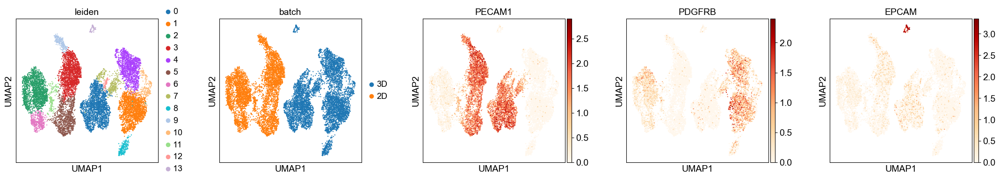

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.40
Detected doublet rate = 1.8%
Estimated detectable doublet fraction = 71.6%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.5%
Elapsed time: 30.7 seconds


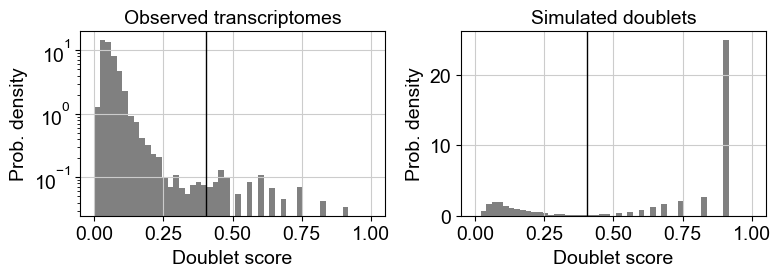

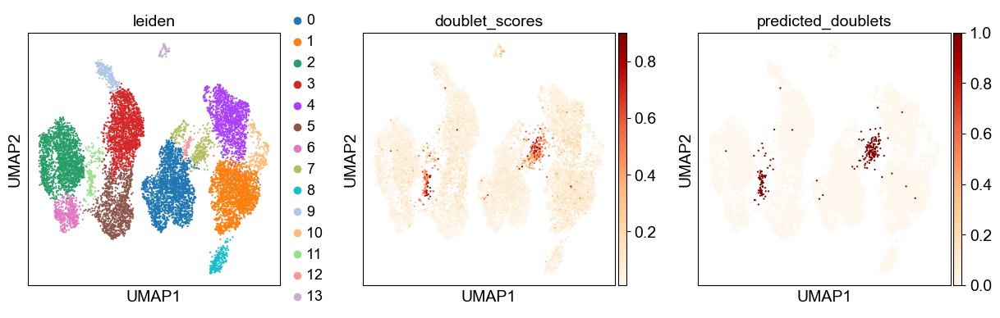

In [13]:
adata=seq.scRNA(adata_raw,0.5)

In [14]:
data=adata.copy()

dubletprediction

In [15]:
adata=ad.AnnData.concatenate(d9_1,d08_McCracken, 
                                join='inner', batch_categories=["3D", '2D'],
                             index_unique='-')

adata=adata[np.isin(adata.obs_names,data.obs_names)]

sc.pp.filter_genes(adata, min_cells=1)
import doubletdetection
clf = doubletdetection.BoostClassifier(
    n_iters=10,
    clustering_algorithm="leiden",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score


data.obs["doublet"]=adata.obs.doublet
data.obs["doublet_score"]=adata.obs.doublet_score

Trying to set attribute `.var` of view, copying.


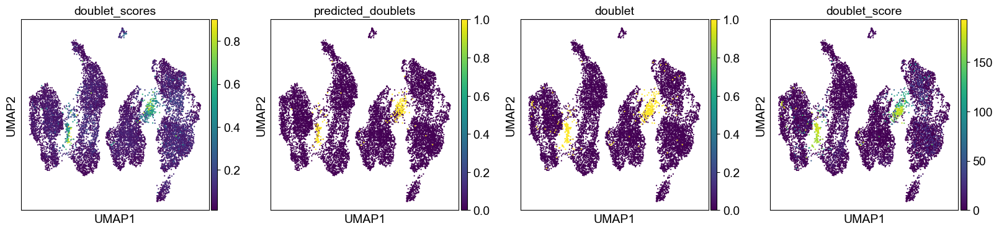

In [16]:
sc.pl.umap(data, color=['doublet_scores','predicted_doublets',"doublet", "doublet_score"
                        ] )

In [17]:
adata=data.copy()

177

190

35

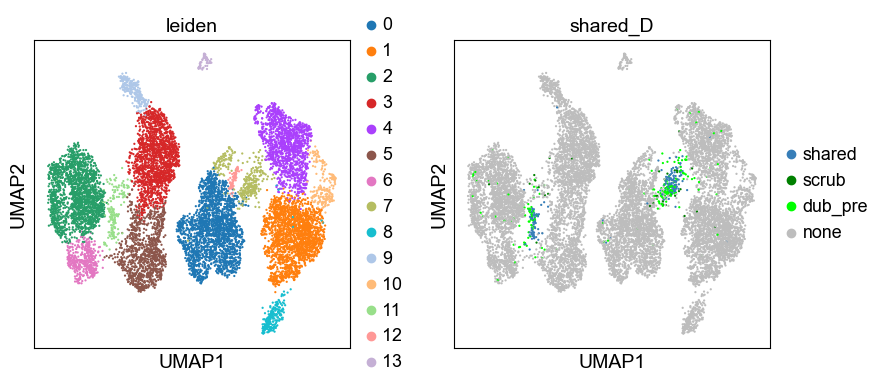

In [18]:
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 1))
ref_cluster = pd.Categorical(adata.obs.shared_D,categories=['True','False','shared','scrub','dub_pre',"none"])
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='shared'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == False) & (adata.obs.doublet == 1))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='dub_pre'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 0))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='scrub'
x = ref_cluster.isna()
ref_cluster[x]='none'

adata.obs['shared_D'] = ref_cluster
adata.obs['shared_D'].cat.remove_unused_categories(inplace=True)
adata.uns['shared_D_colors']=['#377eb8',"green","lime",'#bdbdbd']
# display(ref_cluster)

sc.pl.umap(adata, color=["leiden",  "shared_D"],
#            ncols=3,
#           color_map="OrRd"#,save="20211005_0t09_Coexp.pdf"
          )

In [19]:
pd.crosstab(adata.obs.shared_D,"A")

col_0,A
shared_D,
shared,177
scrub,35
dub_pre,190
none,11233


In [20]:
adata=adata[np.isin(adata.obs.shared_D,["none"])]

Trying to set attribute `.obs` of view, copying.


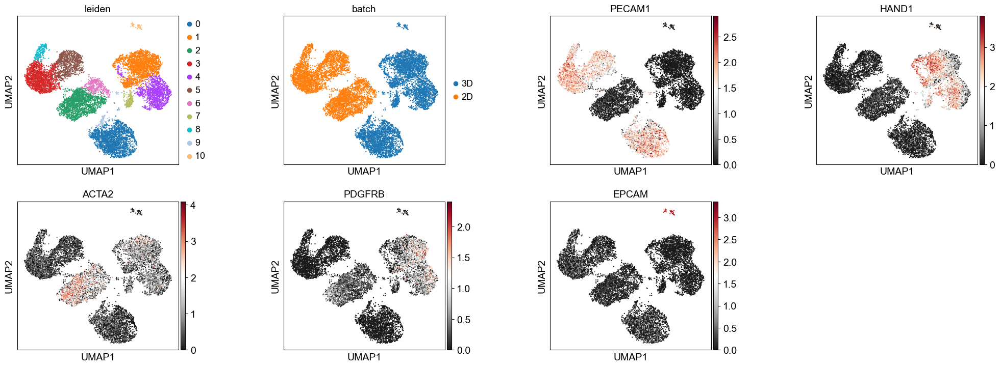

In [24]:
sc.tl.leiden(adata,resolution=0.4)
sc.pl.umap(adata,color=['leiden','batch','PECAM1','HAND1','ACTA2','PDGFRB','EPCAM'],cmap='RdGy_r',
      wspace=.5)

Trying to set attribute `.obs` of view, copying.


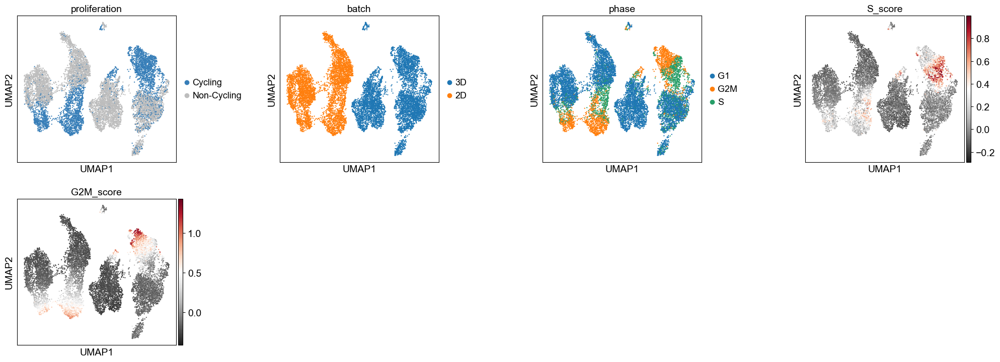

In [21]:
adata=seq.cell_cycle(adata)

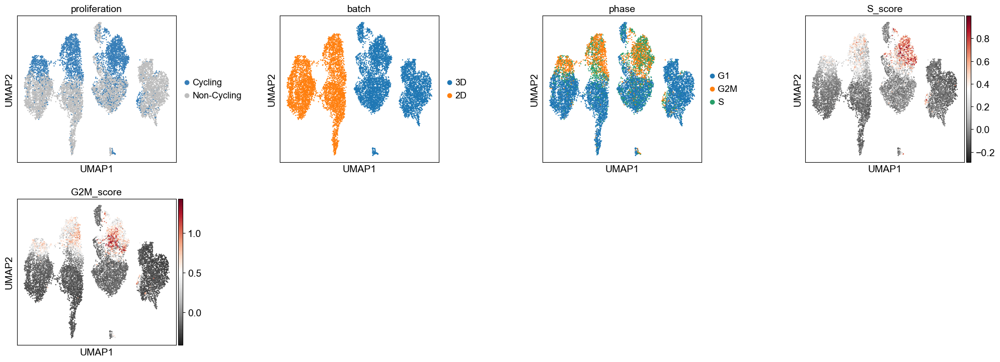

In [22]:
adata=seq.cell_cycle_regression(adata)

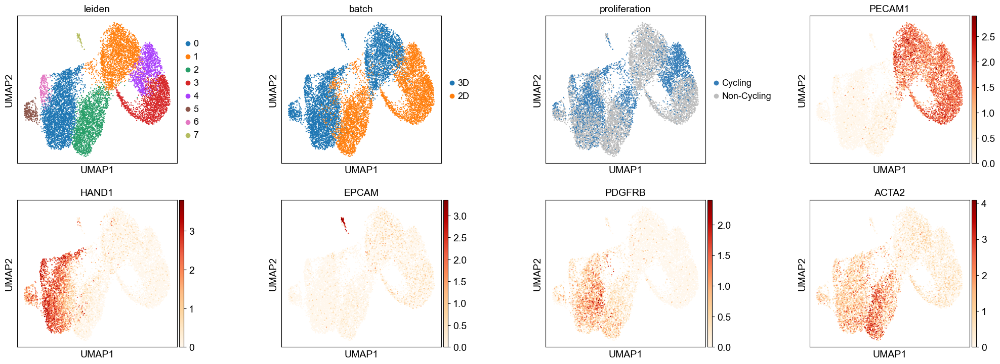

In [29]:
num_pcs = 40
mum_neighbour = 10
adata = bbknn.bbknn(adata, neighbors_within_batch=mum_neighbour, n_pcs=num_pcs, trim=0, 
                              copy=True)
sc.tl.umap(adata)
sc.tl.leiden(adata, resolution=.5)
sc.pl.umap(adata,color=['leiden','batch',"PECAM1","KDR",'ACTA2','PDGFRB','HAND1','EPCAM'],
      wspace=0.6, color_map="OrRd")

remove epithelial population

In [36]:
adata=adata[np.isin(adata.obs.leiden,["{:1d}".format(x) for x in range(7)])]

In [37]:
adata.obs['leiden_anno']=adata.obs['leiden']
ss=adata.obs['leiden_anno']
ss=ss.replace('0','MC')#
ss=ss.replace('1','EC')#
ss=ss.replace('2','MC')
ss=ss.replace('3','EC')
ss=ss.replace('4','EC')#
ss=ss.replace('5','MC')#
ss=ss.replace('6','MC')
adata.obs['leiden_anno']=ss

Trying to set attribute `.obs` of view, copying.


In [38]:
pdf=adata.obs[['leiden',"batch","leiden_anno"]]
pdf["batch_anno"]=pdf["leiden_anno"]
ref_cluster = pd.Categorical(pdf['batch_anno'],categories=['True','False','MC_2D','MC_3D',
                                                           'EC_2D','EC_3D'])
pdf['batch_anno'] = ((pdf.leiden_anno == "MC") & (pdf.batch == "2D"))
x = pdf['batch_anno'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='MC_2D'
pdf['batch_anno'] = ((pdf.leiden_anno == "MC") & (pdf.batch == "3D"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='MC_3D'
display(len([el for el in x if el == True]))
pdf['batch_anno'] = ((pdf.leiden_anno == "EC") & (pdf.batch == "2D"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='EC_2D'
display(len([el for el in x if el == True]))
pdf['batch_anno'] = ((pdf.leiden_anno == "EC") & (pdf.batch == "3D"))
x = pdf['batch_anno'] ==True
ref_cluster[x]='EC_3D'
display(len([el for el in x if el == True]))
ref_cluster
adata.obs['ct_bybatch'] = ref_cluster
adata.obs['ct_bybatch'].cat.remove_unused_categories(inplace=True)

2151

3759

2967

2295

In [42]:
adata.uns['ct_bybatch_colors']=['#279e68', '#abdda4', '#9e0142', '#d6bcc0' ]

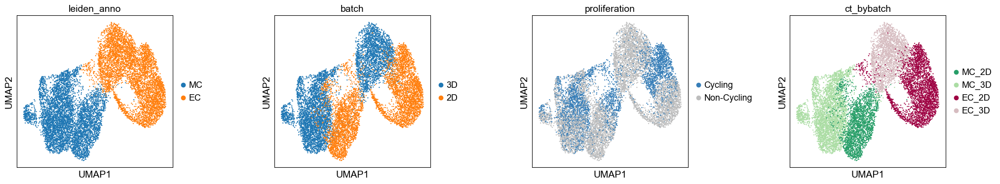

In [43]:
sc.pl.umap(adata, color=["leiden_anno",'batch','proliferation',"ct_bybatch"]
           , 
           use_raw=True,color_map="OrRd",ncols=4,
           wspace=0.5)

In [45]:
adata.write(r"./processed/dataset_5.h5ad",compression="gzip")

## Dataset 6 - 3D suspension vs 3D Matrigel culture on day 12

This dataset is used in Fig. 4

In [7]:
d12_2=sc.read_h5ad('./scanpy_AnnData/MUC18113/filtered_feature_bc_matrix.h5ad', 
                   backed=None, chunk_size=6000)
d12_mc_2=sc.read_h5ad('./scanpy_AnnData/MUC18114/filtered_feature_bc_matrix.h5ad', 
                      backed=None, chunk_size=6000)

In [8]:
adata=ad.AnnData.concatenate(d12_2,d12_mc_2, join='outer', batch_categories=["d12c2","d12m2"],
                             index_unique='-') #combine datasets

Trying to set attribute `.obs` of view, copying.


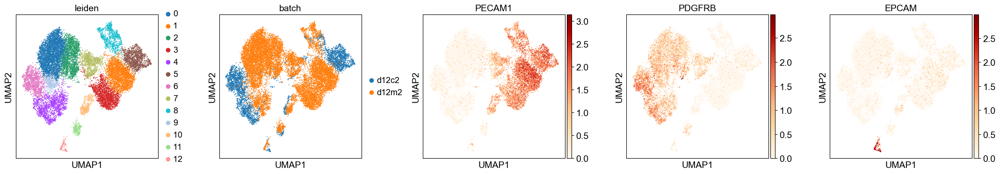

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.46
Detected doublet rate = 3.4%
Estimated detectable doublet fraction = 55.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 6.2%
Elapsed time: 26.2 seconds


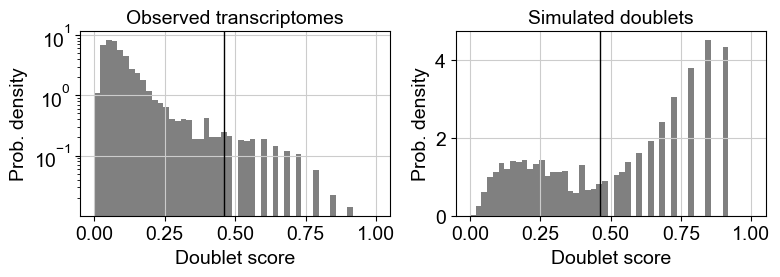

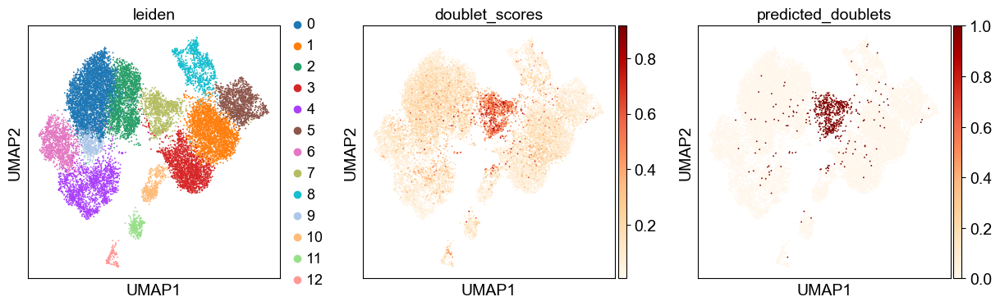

In [9]:
adata=seq.scRNA(adata,.5)

In [10]:
data=adata.copy()

dubletprediction

In [11]:
adata=ad.AnnData.concatenate(d12_2,d12_mc_2, join='outer', batch_categories=["d12c2","d12m2"],
                             index_unique='-') #combine datasets

adata=adata[np.isin(adata.obs_names,data.obs_names)]

sc.pp.filter_genes(adata, min_cells=1)
import doubletdetection
clf = doubletdetection.BoostClassifier(
    n_iters=10,
    clustering_algorithm="leiden",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score


data.obs["doublet"]=adata.obs.doublet
data.obs["doublet_score"]=adata.obs.doublet_score

Trying to set attribute `.var` of view, copying.


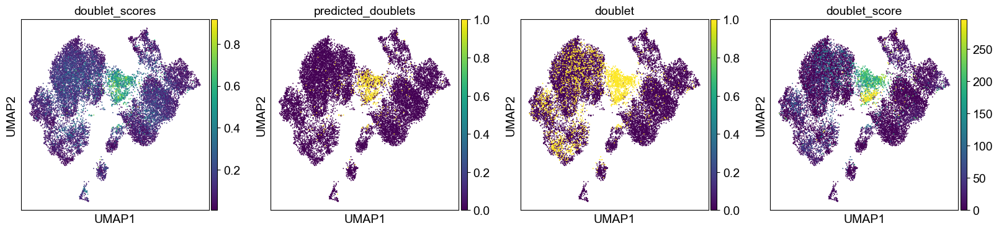

In [12]:
sc.pl.umap(data, color=['doublet_scores','predicted_doublets',"doublet", "doublet_score"
                        ] )

In [13]:
adata=data.copy()

543

1753

55

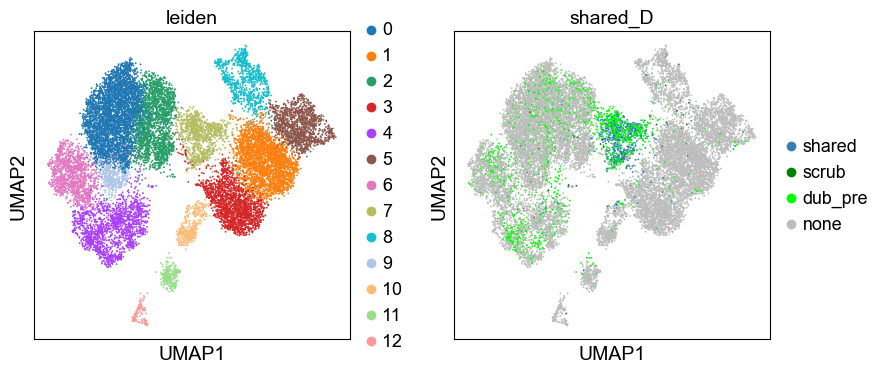

In [14]:
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 1))
ref_cluster = pd.Categorical(adata.obs.shared_D,categories=['True','False','shared','scrub','dub_pre',"none"])
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='shared'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == False) & (adata.obs.doublet == 1))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='dub_pre'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 0))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='scrub'
x = ref_cluster.isna()
ref_cluster[x]='none'

adata.obs['shared_D'] = ref_cluster
adata.obs['shared_D'].cat.remove_unused_categories(inplace=True)
adata.uns['shared_D_colors']=['#377eb8',"green","lime",'#bdbdbd']
# display(ref_cluster)

sc.pl.umap(adata, color=["leiden",  "shared_D"],
#            ncols=3,
#           color_map="OrRd"#,save="20211005_0t09_Coexp.pdf"
          )

In [15]:
pd.crosstab(adata.obs.shared_D,"A")

col_0,A
shared_D,
shared,543
scrub,55
dub_pre,1753
none,15293


In [16]:
adata=adata[np.isin(adata.obs.shared_D,["none"])]

Trying to set attribute `.obs` of view, copying.


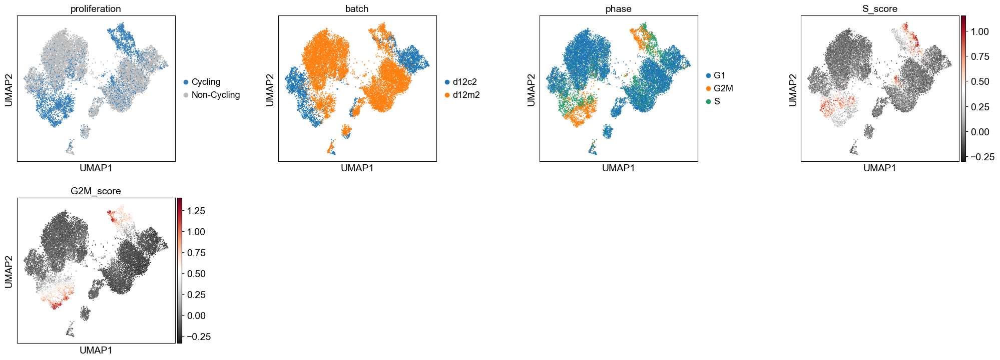

In [17]:
adata=seq.cell_cycle(adata)

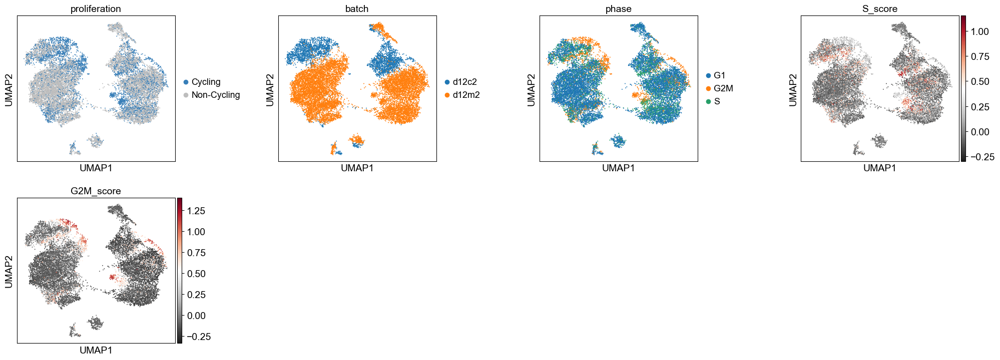

In [18]:
adata=seq.cell_cycle_regression(adata)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p
0,TPM1,0.000000e+00,ESAM,0.000000e+00,COL3A1,0.000000e+00,TPM1,0.000000e+00,GNG11,0.000000e+00,ESAM,0.000000e+00,COL3A1,1.022031e-257,UCHL1,7.653913e-303,UCHL1,1.311131e-169,KRT19,5.624804e-64
1,COL3A1,0.000000e+00,EFNB2,0.000000e+00,FN1,0.000000e+00,COL3A1,0.000000e+00,ESAM,0.000000e+00,ADGRL4,0.000000e+00,TPM1,9.232689e-231,UBC,1.793203e-221,PLD3,2.546696e-149,SPINT2,3.910029e-63
2,TAGLN,0.000000e+00,ADGRL4,0.000000e+00,TPM1,0.000000e+00,TPM2,0.000000e+00,EMCN,0.000000e+00,IGFBP4,0.000000e+00,MDK,1.271833e-179,GAPDH,1.430872e-213,CTSD,1.029977e-132,EPCAM,1.777051e-62
3,FN1,0.000000e+00,FLT1,0.000000e+00,MDK,0.000000e+00,MDK,0.000000e+00,TM4SF18,0.000000e+00,PRCP,0.000000e+00,FTL,2.339673e-141,SOD1,3.027039e-213,SOD1,1.309137e-130,APOE,3.598558e-60
4,TPM2,0.000000e+00,PLVAP,0.000000e+00,APOE,0.000000e+00,TAGLN,0.000000e+00,KDR,0.000000e+00,CDH5,0.000000e+00,FN1,5.532530e-117,CTSD,1.011953e-203,MAP1A,1.361159e-117,APOA2,6.416174e-59
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,RPL27,4.170502e-130,ITGA2,1.063607e-151,LSM3,2.353333e-85,ACTG2,5.197441e-66,RAB32,3.052070e-64,CYSLTR1,1.344755e-156,TUSC3,1.971925e-13,LMO2,5.196231e-32,MICALL2,2.224414e-19,ZFP36L2,2.760116e-10
296,CDK6,1.798444e-129,KTN1,1.809177e-151,TP53I11,4.986007e-85,TMED3,2.150041e-66,FRMD4A,3.046664e-64,SCARF1,1.074549e-156,TIMP2,2.056201e-13,HMOX1,1.407036e-31,DDX27,2.064240e-19,SHTN1,2.876204e-10
297,ADAM19,5.944308e-128,ATP11A,4.512179e-148,ANAPC11,1.270462e-85,NES,2.863066e-66,GMFG,6.521454e-64,SSTR1,3.693626e-155,RCN1,2.248030e-13,RTCA,1.098408e-31,RAB27B,3.327174e-19,JADE1,2.909839e-10
298,CALM2,1.258548e-129,TPT1,1.052533e-151,DEPDC1,1.363932e-83,CRLF1,9.080323e-65,NOVA2,7.908833e-64,TP53INP2,3.155561e-156,OSBPL1A,2.386919e-13,BTF3,7.508960e-32,MAP1LC3B,3.189122e-19,ATP2B1,3.034694e-10


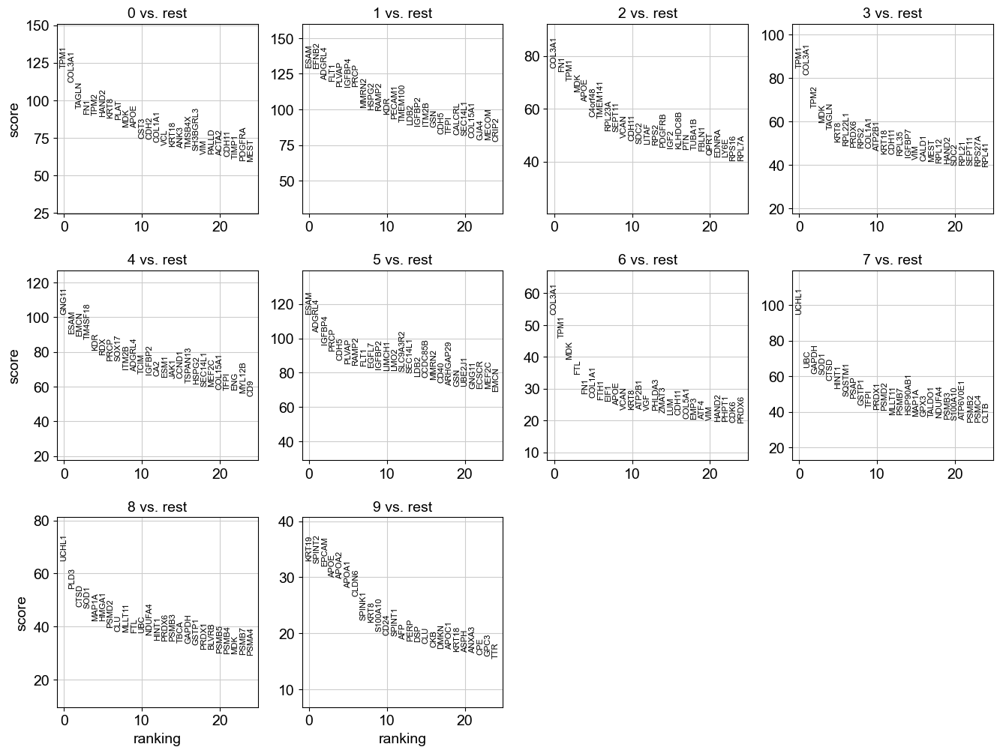

In [20]:
pdf=seq.Rank_Genes(adata,"leiden")
pdf#.to_excel('/home/srosowski/Python/write/sec_seq/day12_mc_c/20200817_DiffExpGens_'+
    #         'day_12_12_cm_celltypes_combat'+
     #        '.xlsx')

In [21]:
pdf[[el for el in pdf.columns if "n" in el]].iloc[:20,:]

,0_n,1_n,2_n,3_n,4_n,5_n,6_n,7_n,8_n,9_n
0,TPM1,ESAM,COL3A1,TPM1,GNG11,ESAM,COL3A1,UCHL1,UCHL1,KRT19
1,COL3A1,EFNB2,FN1,COL3A1,ESAM,ADGRL4,TPM1,UBC,PLD3,SPINT2
2,TAGLN,ADGRL4,TPM1,TPM2,EMCN,IGFBP4,MDK,GAPDH,CTSD,EPCAM
3,FN1,FLT1,MDK,MDK,TM4SF18,PRCP,FTL,SOD1,SOD1,APOE
4,TPM2,PLVAP,APOE,TAGLN,KDR,CDH5,FN1,CTSD,MAP1A,APOA2
5,HAND2,IGFBP4,C4orf48,KRT8,RDX,PLVAP,COL1A1,HINT1,HMGA1,APOA1
6,KRT8,PRCP,TMEM141,RPL22L1,PRCP,RAMP2,FTH1,SQSTM1,PSMD2,CLDN6
7,PLAT,MMRN2,RPL23A,PRDX6,SOX17,FLT1,EIF1,PSAP,CLU,SPINK1
8,MDK,HSPG2,SEPT11,RPS2,ITM2B,EGFL7,APOE,GSTP1,MLLT11,KRT8
9,APOE,RAMP2,VCAN,COL1A1,ADGRL4,IGFBP2,VCAN,TFPI,FTL,S100A10


removal of clusters with dying (high content of ubiquitine and proteasome gene expression) and epithelial cells
"UBC","UCHL1","PLD3","PSMD2"

In [41]:
adata.uns["batch_colors"]=['#65c3bf', '#d3e4f3']

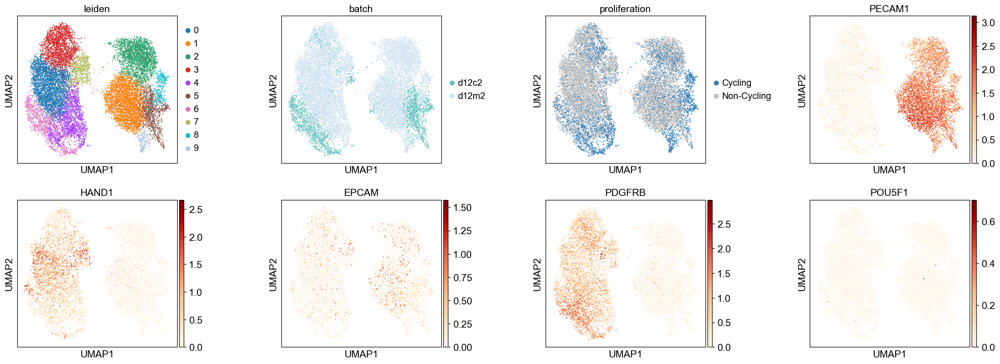

In [18]:
sc.pp.combat(adata,key="batch")
sc.tl.umap(adata)
sc.tl.leiden(adata,resolution=0.5)
sc.pl.umap(adata, color=["leiden",'batch','proliferation',
                      'PECAM1','HAND1','EPCAM','PDGFRB','POU5F1',]#+list(pdf.iloc[:5,4])
           , 
           use_raw=True,color_map="OrRd",ncols=4,
           wspace=0.5)

In [24]:
adata.obs['leiden_anno']=adata.obs['leiden']
ss=adata.obs['leiden_anno']
ss=ss.replace('0','mural')#
ss=ss.replace('1','coalescing')#
ss=ss.replace('2','sprouting')
ss=ss.replace('3','mural')
ss=ss.replace('4','mural')#
ss=ss.replace('5','angioblast')#
ss=ss.replace('6','mural_1')
ss=ss.replace('7','mural')
ss=ss.replace('8','coalescing_proliferating')
ss=ss.replace('9','coalescing_proliferating')
adata.obs['leiden_anno']=ss

In [38]:
adata.obs['leiden_anno'].cat.reorder_categories([
        'mural', 'mural_1', 'angioblast', 'coalescing',
               'coalescing_proliferating', 'sprouting'], inplace=True)


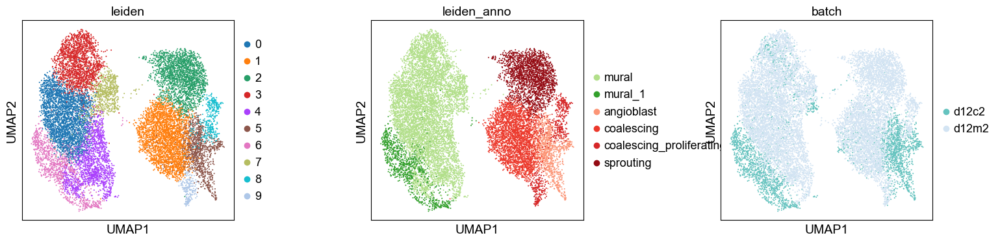

In [19]:
adata.uns["leiden_anno_colors"]=['#b2df8a', '#33a02c', 
#                                  '#fd994d', 
                                 '#fc9576', '#ec382b', '#ff7f00', '#940b13']
sc.pl.umap(adata,color=["leiden","leiden_anno",
                        "batch"],wspace=.5)

In [44]:
adata.write(r"./processed/dataset_6.h5ad",compression="gzip")

## Dataset 7 - 3D suspension vs 3D Matrigel culture on day 12, velocity integration

This dataset is used in Fig. 4

In [20]:
adata=sc.read_h5ad(r"./processed/dataset_6.h5ad",compression="gzip")

In [21]:
import loompy
# read loom unspliced spliced data
loompy.combine([glob.glob(r'./velocyto/MUC18113/*.loom')[0],
                glob.glob(r'./velocyto/MUC18114/*.loom')[0]],
               r'./processed/day12mc_combined.loom')

In [25]:
name_l=list()
for i in range(len(adata.obs.batch.cat.categories)):
    descr=glob.glob(r'./velocyto/MUC1811'+str(i+3)+'/*.loom')[0]
    print(descr)
    name_l.append(descr[-10:-5])
name_l

./velocyto/MUC18113\possorted_genome_bam_KYSDO.loom
./velocyto/MUC18114\possorted_genome_bam_9V6BU.loom


['KYSDO', '9V6BU']

In [29]:
adata=seq.trans_to_splice(adata,'./processed/day12mc_combined.loom',name_l)

adata.write(save_path+todayd+'_'+'pre_scv_dataset_7.h5ad',compression="gzip")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


Filtered out 4451 genes that are detected in less than 3 cells (spliced).
Filtered out 4901 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 1/8 cores)



    finished (1:22:31) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:08) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)



    finished (0:01:43) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:04) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


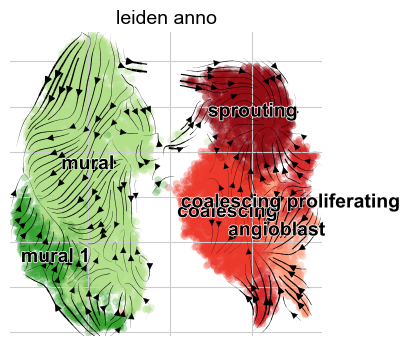

computing terminal states
    identified 9 regions of root cells and 2 regions of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


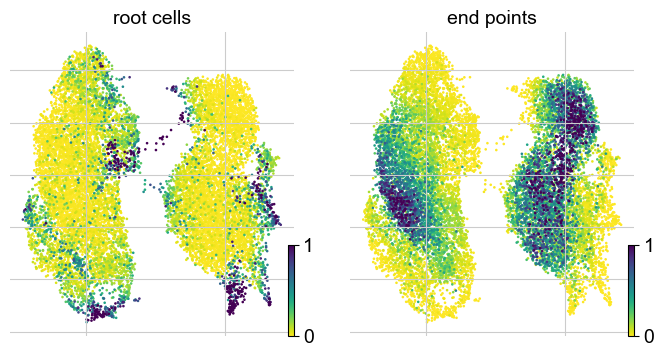

computing latent time using root_cells as prior
    finished (0:00:07) --> added 
    'latent_time', shared time (adata.obs)


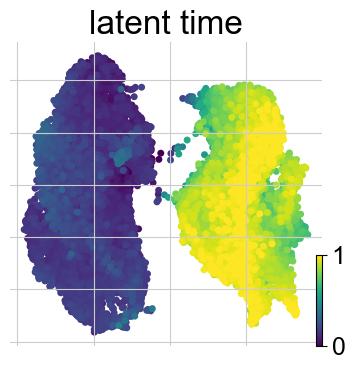

In [37]:
nr=[2000]
datalist=nr.copy()
for i in range(len(nr)):
    a=adata.copy()
    a.var_names_make_unique()
    a.var_names_make_unique()
    scv.pp.filter_and_normalize(a, 
                                min_cells=3,
                                min_counts=2,
                                min_shared_counts=20, 
                                n_top_genes=nr[i])
    scv.pp.moments(a, n_pcs=40, n_neighbors=10)
    scv.tl.recover_dynamics(a)
    #velocity
    scv.tl.velocity(a, mode='dynamical')
    scv.tl.velocity_graph(a)
    scv.pl.velocity_embedding_stream(a, basis='umap',color='leiden_anno')

    scv.tl.terminal_states(a)
    scv.pl.scatter(a, color=['root_cells', 'end_points'])
    scv.tl.recover_latent_time(a)
    scv.pl.scatter(a, color='latent_time', fontsize=24, size=100,
                   color_map='viridis', perc=[2, 98], colorbar=True, rescale_color=[0,1])
    a.write('./processed/dataset_7.h5ad',compression="gzip")

## Dataset 8 - 3D suspension vs 3D Matrigel culture on day 18

This dataset is used in Fig. 5

In [30]:
d12_mc_2=sc.read_h5ad('./scanpy_AnnData/MUC18114/filtered_feature_bc_matrix.h5ad',
                  backed=None, chunk_size=6000)
d18_mc_2=sc.read_h5ad('./scanpy_AnnData/MUC18115/filtered_feature_bc_matrix.h5ad',
                  backed=None, chunk_size=6000)
d18_aa_2=sc.read_h5ad('./scanpy_AnnData/MUC18116/filtered_feature_bc_matrix.h5ad',
                  backed=None, chunk_size=6000)

Trying to set attribute `.obs` of view, copying.


Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.30
Detected doublet rate = 5.3%
Estimated detectable doublet fraction = 72.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 7.3%
Elapsed time: 121.5 seconds


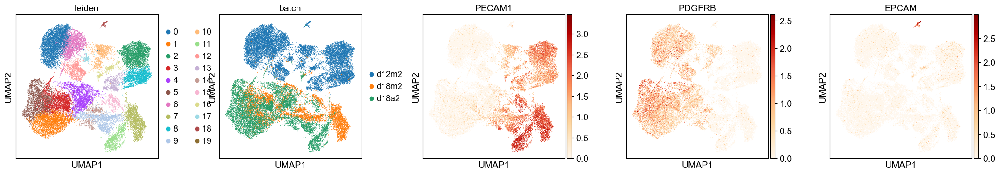

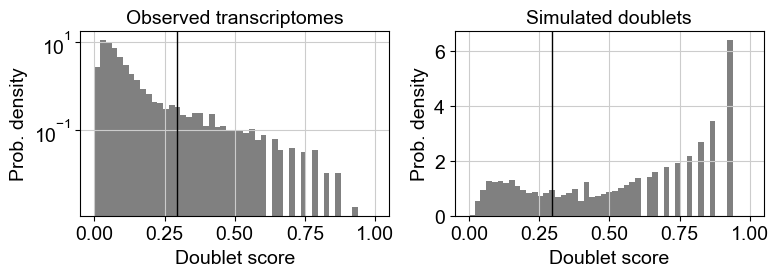

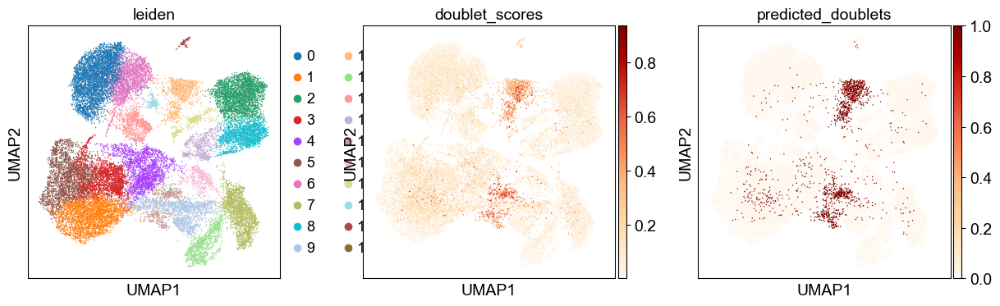

In [31]:
day1218cm=ad.AnnData.concatenate(d12_mc_2, d18_mc_2,d18_aa_2,
                             join='outer', 
                             batch_categories=['d12m2', 'd18m2', 'd18a2'],
                             index_unique='-') #combine datasets
adata=seq.scRNA(day1218cm,.5)

In [32]:
data=adata.copy()

dubletprediction

In [33]:
adata=ad.AnnData.concatenate(d12_mc_2, d18_mc_2,d18_aa_2,
                             join='outer', 
                             batch_categories=['d12m2', 'd18m2', 'd18a2'],
                             index_unique='-') #combine datasets

adata=adata[np.isin(adata.obs_names,data.obs_names)]

sc.pp.filter_genes(adata, min_cells=1)
import doubletdetection
clf = doubletdetection.BoostClassifier(
    n_iters=10,
    clustering_algorithm="leiden",
    standard_scaling=True,
    pseudocount=0.1,
    n_jobs=-1,
)
doublets = clf.fit(adata.X).predict(p_thresh=1e-16, voter_thresh=0.5)
doublet_score = clf.doublet_score()
adata.obs["doublet"] = doublets
adata.obs["doublet_score"] = doublet_score


data.obs["doublet"]=adata.obs.doublet
data.obs["doublet_score"]=adata.obs.doublet_score

Trying to set attribute `.var` of view, copying.


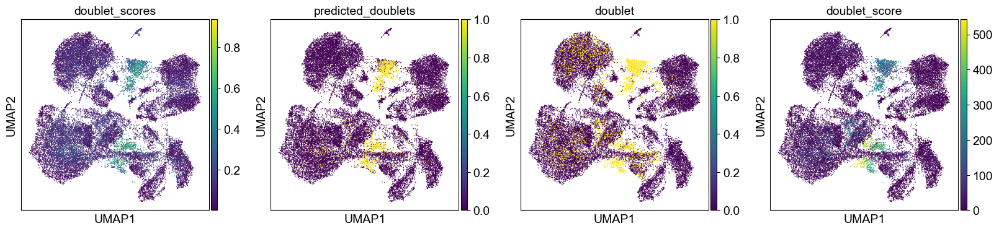

In [34]:
sc.pl.umap(data, color=['doublet_scores','predicted_doublets',"doublet", "doublet_score"
                        ] )

In [35]:
adata=data.copy()

1210

2208

311

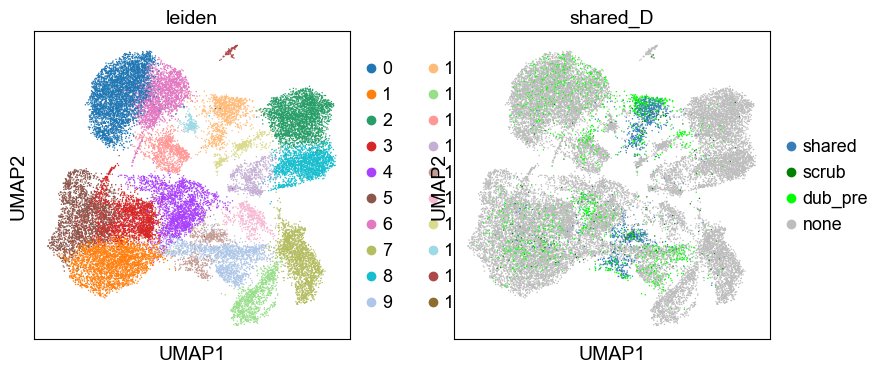

In [36]:
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 1))
ref_cluster = pd.Categorical(adata.obs.shared_D,categories=['True','False','shared','scrub','dub_pre',"none"])
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='shared'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == False) & (adata.obs.doublet == 1))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='dub_pre'
adata.obs['shared_D'] = ((adata.obs.predicted_doublets == True) & (adata.obs.doublet == 0))
x = adata.obs['shared_D'] ==True
display(len([el for el in x if el == True]))
ref_cluster[x]='scrub'
x = ref_cluster.isna()
ref_cluster[x]='none'

adata.obs['shared_D'] = ref_cluster
adata.obs['shared_D'].cat.remove_unused_categories(inplace=True)
adata.uns['shared_D_colors']=['#377eb8',"green","lime",'#bdbdbd']
# display(ref_cluster)

sc.pl.umap(adata, color=["leiden",  "shared_D"],
#            ncols=3,
#           color_map="OrRd"#,save="20211005_0t09_Coexp.pdf"
          )

In [37]:
pd.crosstab(adata.obs.shared_D,"A")

col_0,A
shared_D,
shared,1210
scrub,311
dub_pre,2208
none,25006


In [38]:
adata=adata[np.isin(adata.obs.shared_D,["none"])]

Trying to set attribute `.obs` of view, copying.


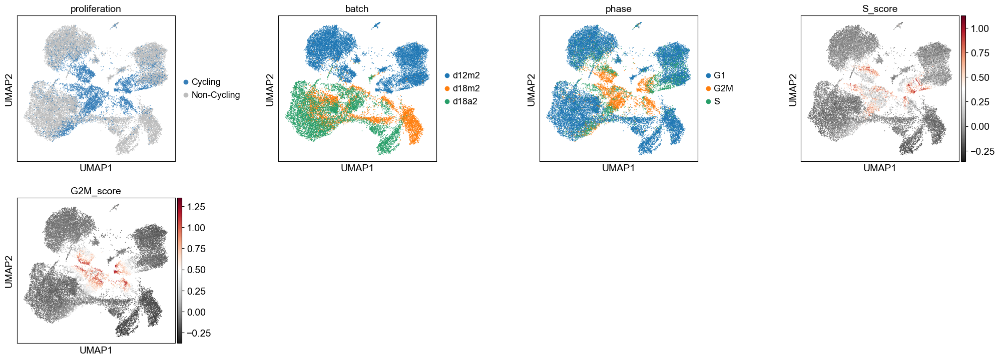

In [39]:
adata=seq.cell_cycle(adata)

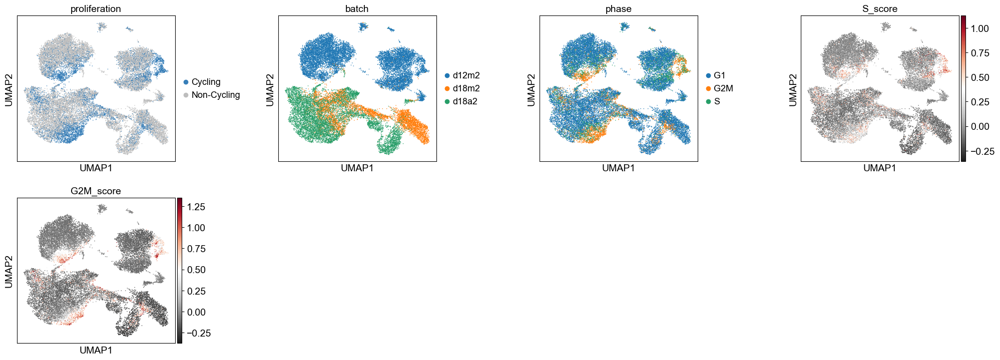

In [40]:
adata=seq.cell_cycle_regression(adata)

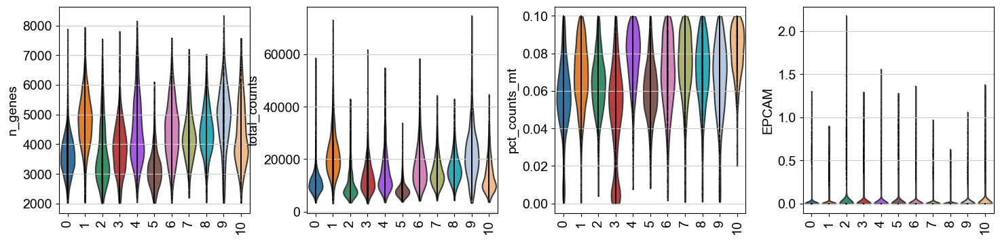

In [48]:
sc.pl.violin(adata, ['n_genes', 'total_counts', 'pct_counts_mt',"EPCAM"],
             groupby="leiden",rotation=90,wspace=1,
         jitter=0,#.4, 
             multi_panel=True)

ranking genes
    finished (0:00:09)


,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p
0,TPM1,0.000000e+00,IGFBP5,0.000000e+00,ESAM,0.000000e+00,TPM1,0.000000e+00,CDH5,0.000000e+00,...,IGFBP7,0.000000e+00,ARHGDIB,0.000000e+00,PDLIM3,0.000000e+00,TPM1,0.000000e+00,PECAM1,0.000000e+00
1,MDK,0.000000e+00,LGALS1,0.000000e+00,ADGRL4,0.000000e+00,MDK,0.000000e+00,ADGRL4,0.000000e+00,...,TPM1,0.000000e+00,GNG11,0.000000e+00,COL3A1,0.000000e+00,TGFBI,0.000000e+00,CDH5,0.000000e+00
2,APOE,0.000000e+00,NNMT,0.000000e+00,EFNB2,0.000000e+00,COL3A1,0.000000e+00,PECAM1,0.000000e+00,...,CALD1,0.000000e+00,S100A16,0.000000e+00,IGFBP7,0.000000e+00,MEST,0.000000e+00,CD93,0.000000e+00
3,C4orf48,0.000000e+00,TMSB4X,0.000000e+00,FLT1,0.000000e+00,RPS29,0.000000e+00,PRCP,0.000000e+00,...,COL3A1,0.000000e+00,GBP4,0.000000e+00,CCDC3,0.000000e+00,TMSB4X,3.471305e-320,EFNB2,0.000000e+00
4,HAND2,0.000000e+00,RPL22L1,0.000000e+00,PRCP,0.000000e+00,ATP2B1,0.000000e+00,ESAM,0.000000e+00,...,TAGLN,0.000000e+00,TM4SF1,0.000000e+00,CDH2,0.000000e+00,KRT8,4.032227e-285,ADGRL4,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,SEMA3C,8.246033e-109,TIMM17A,2.693580e-190,RAB11A,5.634085e-159,ITPRID2,3.185066e-57,RAPGEF2,5.831793e-195,...,SLC8A1,1.929191e-80,CDKN1B,2.805636e-50,PTGFRN,6.506330e-81,LSAMP,3.729121e-56,JMJD1C,4.535045e-136
296,SNRNP27,2.373458e-109,TALDO1,8.489088e-190,MDFI,1.282292e-157,LSM5,3.588019e-57,ZFAND5,3.144391e-196,...,SELENOW,2.321128e-81,SP100,4.162768e-50,CASP4,9.129446e-81,EHD2,3.324780e-56,ENTPD1,4.071761e-134
297,GATA6,3.038462e-108,SSBP1,2.548627e-190,CD46,1.431838e-157,TDG,4.487744e-57,WASF2,2.352228e-197,...,PCDH18,1.825087e-80,TGFBR2,3.144661e-50,CALR,9.649604e-82,MLLT11,1.623325e-56,KLF3,1.996371e-134
298,MAN2A1,4.418819e-108,UQCC2,1.781712e-189,ARPC3,4.344091e-158,BST2,7.528314e-57,EXOC3L2,6.752266e-193,...,BMP1,2.082702e-80,NAXE,1.145985e-49,SYNGR1,1.726725e-80,ASPH,3.477259e-56,SLC44A1,7.731081e-135


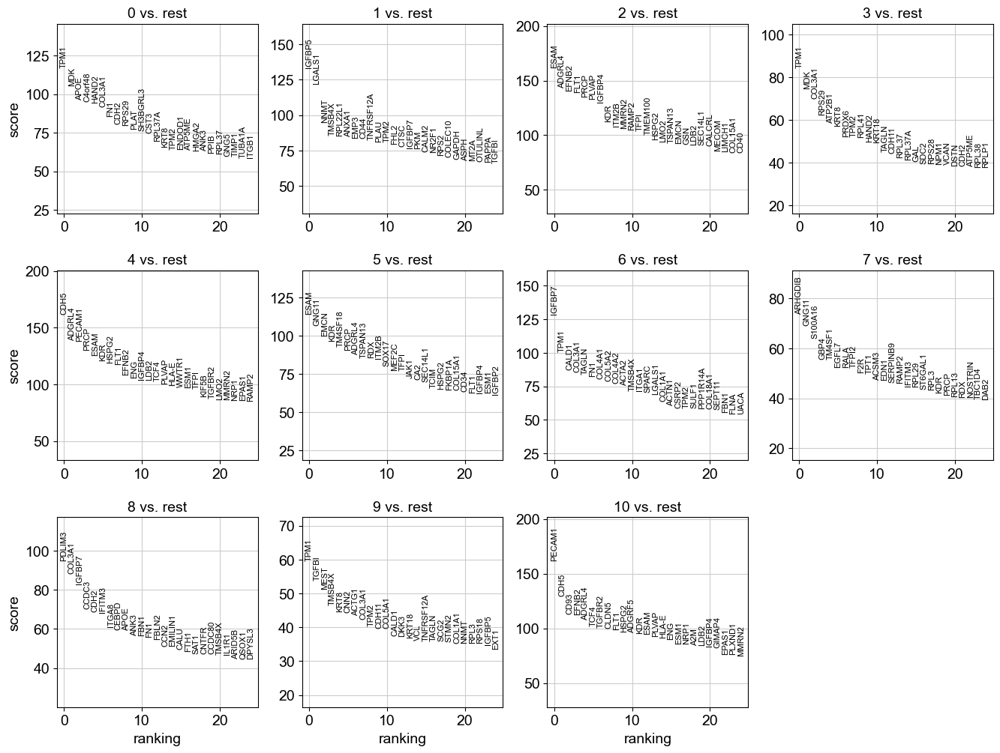

In [49]:
pdf=seq.Rank_Genes(adata,"leiden")
pdf

In [50]:
pdf[[el for el in pdf.columns if "n" in el]].iloc[1:20,:]

,0_n,1_n,2_n,3_n,4_n,5_n,6_n,7_n,8_n,9_n,10_n
1,MDK,LGALS1,ADGRL4,MDK,ADGRL4,GNG11,TPM1,GNG11,COL3A1,TGFBI,CDH5
2,APOE,NNMT,EFNB2,COL3A1,PECAM1,EMCN,CALD1,S100A16,IGFBP7,MEST,CD93
3,C4orf48,TMSB4X,FLT1,RPS29,PRCP,KDR,COL3A1,GBP4,CCDC3,TMSB4X,EFNB2
4,HAND2,RPL22L1,PRCP,ATP2B1,ESAM,TM4SF18,TAGLN,TM4SF1,CDH2,KRT8,ADGRL4
5,COL3A1,ANXA1,PLVAP,KRT8,KDR,PRCP,FN1,EGFL7,IFITM3,CNN2,TCF4
6,FN1,EMP3,IGFBP4,PRDX6,HSPG2,ADGRL4,COL4A1,RALA,ITGA8,ACTG1,TGFBR2
7,CDH2,CD44,KDR,TPM2,FLT1,TSPAN13,COL5A2,TFPI2,CEBPD,COL3A1,CLDN5
8,RPS29,TNFRSF12A,ITM2B,RPL41,EFNB2,RDX,COL4A2,F2R,APOE,TPM2,FLT1
9,PLAT,PLAU,MMRN2,HAND2,ENG,ITM2B,ACTA2,TPT1,ANK3,CDH11,HSPG2
10,SH3BGRL3,TPM2,RAMP2,KRT18,IGFBP4,SOX17,TMSB4X,ACSM3,FBN1,COL5A1,ADGRF5


In [15]:
adata.uns['batch_colors']=["#d3e4f3", "#1f93c0", "#13266fff"]

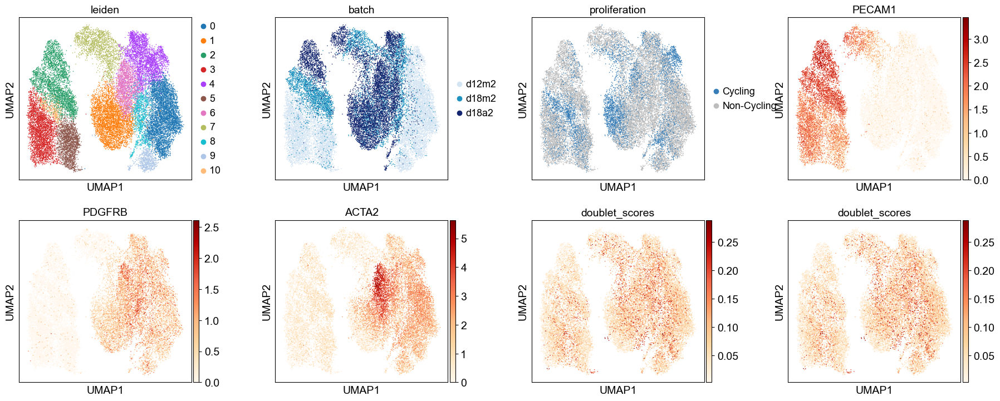

In [18]:
# removal of dying cells clusters and epithelial
adata=adata[np.isin(adata.obs.leiden,["{:1d}".format(x) for x in range(11)])]
sc.pp.combat(adata,key="batch")
sc.tl.umap(adata)
sc.tl.leiden(adata)
sc.pl.umap(adata,
           color=["leiden","batch", "proliferation",
                  "PECAM1","PDGFRB", "ACTA2",
                  'doublet_scores','doublet_scores'],
           color_map="OrRd",wspace=.35)

In [52]:
adata.obs['leiden_anno']=adata.obs['leiden']
ss=adata.obs['leiden_anno']
ss=ss.replace('0','mural_1')#
ss=ss.replace('1','mural_2')#
ss=ss.replace('2','tubulogenic_ECs')
ss=ss.replace('3','coalecing_ECs')
ss=ss.replace('4','mural_3')#
ss=ss.replace('5','sprouting_ECs')#
ss=ss.replace('6','mural_2')
ss=ss.replace('7','MEndoT')
ss=ss.replace('8','mural_2')
ss=ss.replace('9','mural_1')
ss=ss.replace('10','coalecing_ECs')
adata.obs['leiden_anno']=ss

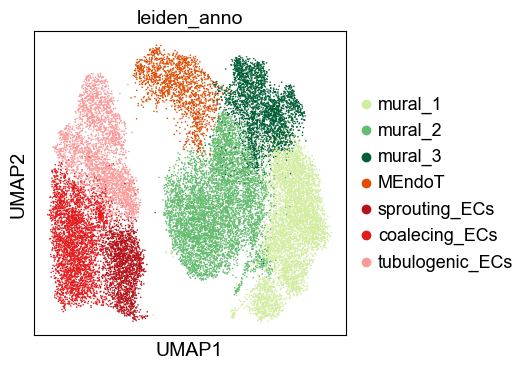

In [19]:
adata.obs['leiden_anno'].cat.reorder_categories([
    'mural_1', 'mural_2',  'mural_3',
        'MEndoT', 'sprouting_ECs', 'coalecing_ECs','tubulogenic_ECs'], inplace=True)

adata.uns['leiden_anno_colors']=["#d2eda0", "#64bc6f", "#005e33", "#dd4d04", "#b61319", "#e31a1c", "#fb9a99"]

sc.pl.umap(adata, color=["leiden_anno"],wspace=.6,
          )

In [27]:
adata.write('./processed/dataset_8.h5ad')

## Dataset 9 - 3D suspension vs 3D Matrigel culture on day 18, velocity integration

This dataset is used in Fig. 5

In [60]:
adata=sc.read_h5ad('./processed/dataset_8.h5ad')

In [61]:
import loompy
# read loom unspliced spliced data
loompy.combine([glob.glob(r'./velocyto/MUC18114/*.loom')[0],
                glob.glob(r'./velocyto/MUC18115/*.loom')[0],
                glob.glob(r'./velocyto/MUC18116/*.loom')[0] ],
               r"./processed/day_12to18_combined.loom")

In [64]:
name_l=list()
for i in range(len(adata.obs.batch.cat.categories)):
    descr=glob.glob(r'./velocyto/MUC1811'+str(i+4)+'/*.loom')[0]
    print(descr)
    name_l.append(descr[-10:-5])
name_l

./velocyto/MUC18114\possorted_genome_bam_9V6BU.loom
./velocyto/MUC18115\possorted_genome_bam_R6YQD.loom
./velocyto/MUC18116\possorted_genome_bam_E94I5.loom


['9V6BU', 'R6YQD', 'E94I5']

In [65]:
adata=seq.trans_to_splice(adata,"./processed/day_12to18_combined.loom",name_l)
adata.write(save_path+todayd+'_'+'pre_scv_'+filename+'.h5ad',compression="gzip")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
... storing 'Chromosome' as categorical
... storing 'Strand' as categorical


Filtered out 4040 genes that are detected in less than 3 cells (spliced).
Filtered out 4739 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:07) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 1/8 cores)



    finished (1:54:17) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:57) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)



    finished (0:01:43) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


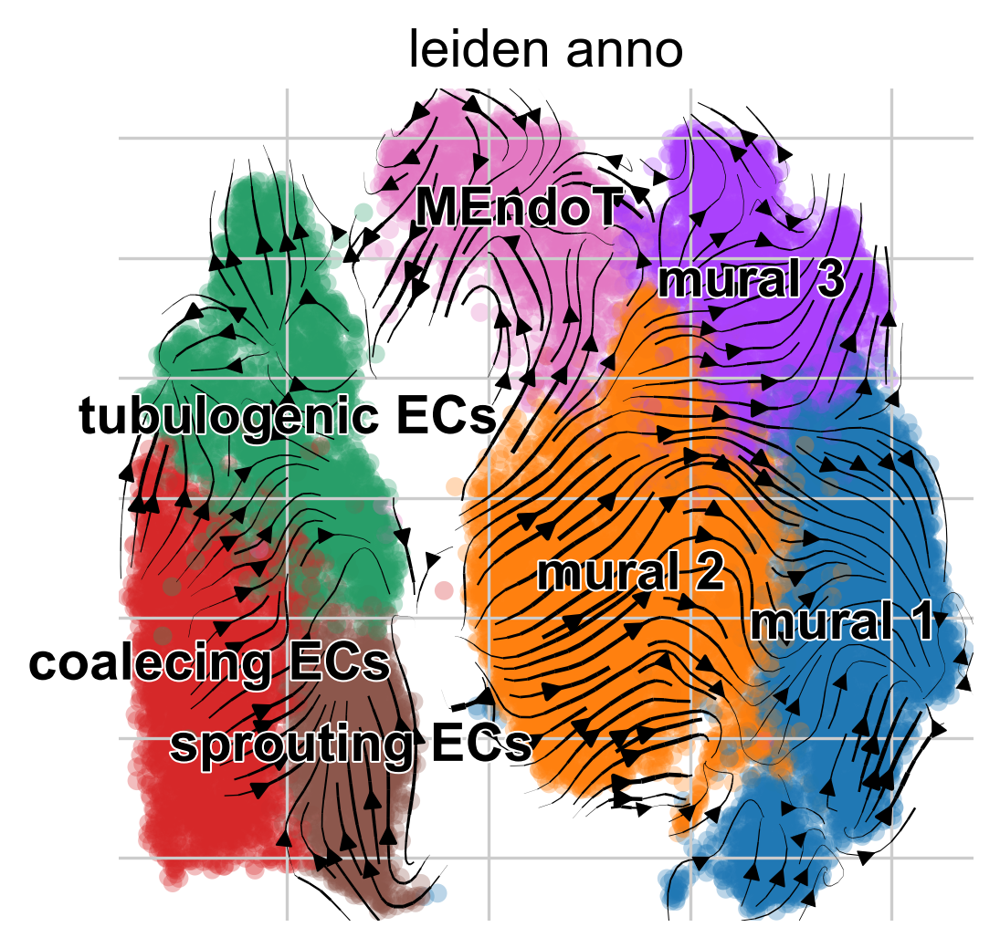

computing terminal states
    identified 10 regions of root cells and 2 regions of end points .
    finished (0:00:03) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


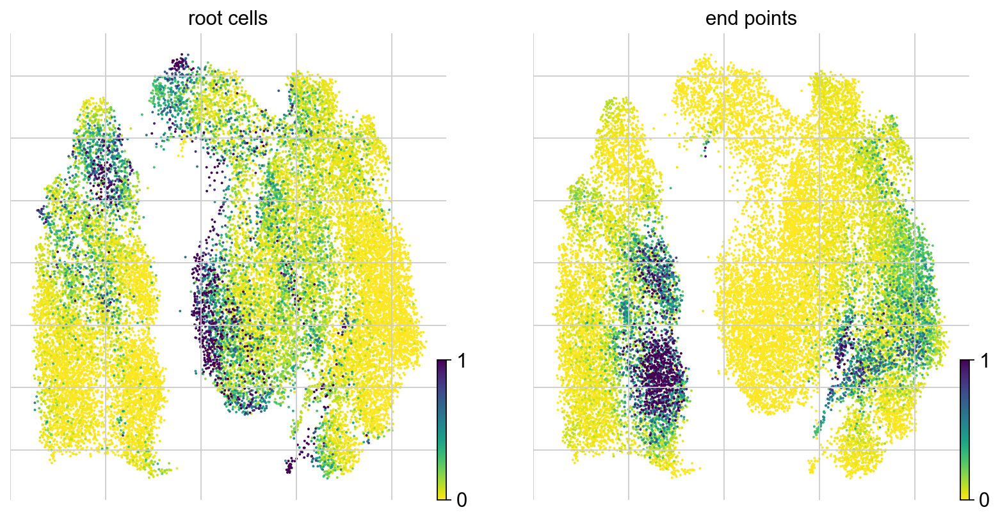

computing latent time using root_cells as prior
    finished (0:00:22) --> added 
    'latent_time', shared time (adata.obs)


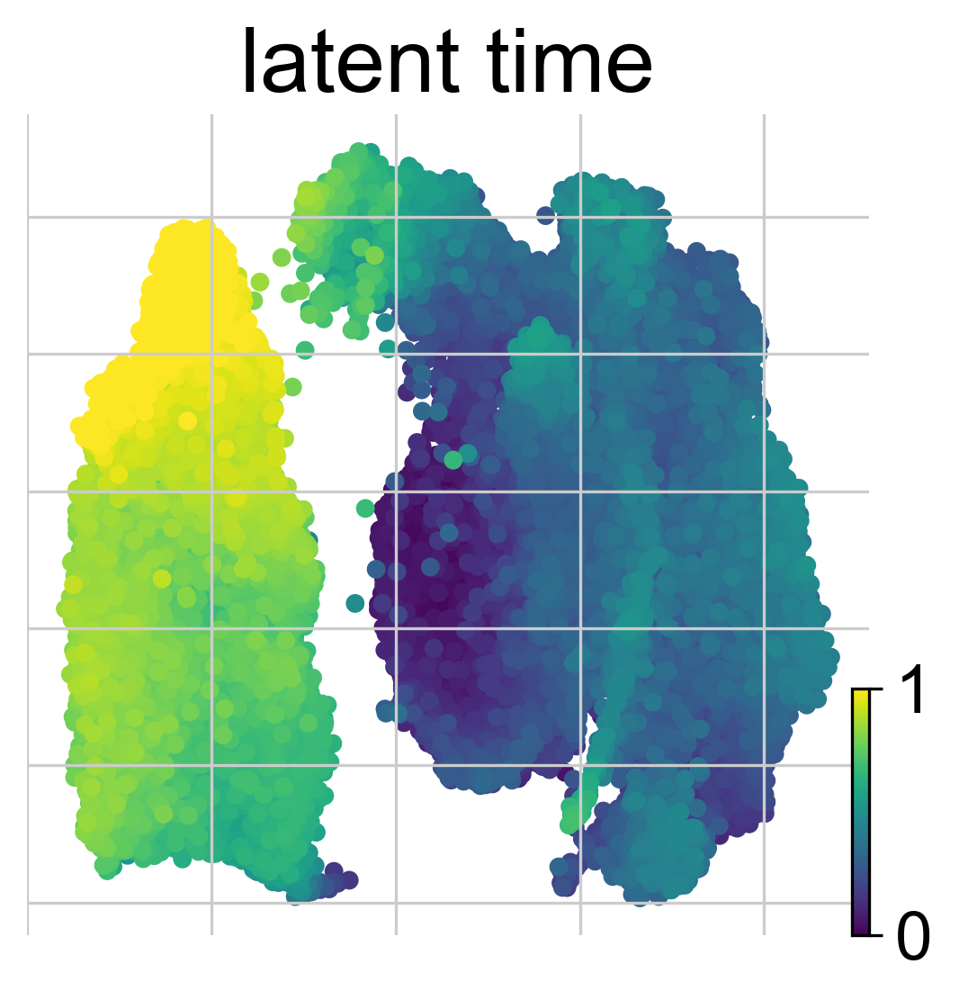

In [68]:
nr=[2000]
datalist=nr.copy()
for i in range(len(nr)):
    a=adata.copy()
    a.var_names_make_unique()
    a.var_names_make_unique()
    scv.pp.filter_and_normalize(a, 
                                min_cells=3,
                                min_counts=2,
                                min_shared_counts=20, 
                                n_top_genes=nr[i])
    scv.pp.moments(a, n_pcs=40, n_neighbors=10)
    scv.tl.recover_dynamics(a)
    #velocity
    scv.tl.velocity(a, mode='dynamical')
    scv.tl.velocity_graph(a)
    scv.pl.velocity_embedding_stream(a, basis='umap',color='leiden_anno')

    scv.tl.terminal_states(a)
    scv.pl.scatter(a, color=['root_cells', 'end_points'])
    scv.tl.recover_latent_time(a)
    scv.pl.scatter(a, color='latent_time', fontsize=24, size=100,
                   color_map='viridis', perc=[2, 98], colorbar=True, rescale_color=[0,1])
    a.write('./processed/dataset_9.h5ad',compression="gzip")